Required libraries for this project

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import plotly.offline as py
import plotly.express as px
import plotly.graph_objs as go
import plotly.tools as tls
plt.style.use('fivethirtyeight')
import scipy.stats as stats
import statsmodels.api as sm
from scipy.stats import pearsonr, ttest_ind, ttest_1samp, norm, mannwhitneyu, t
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import LinearRegression, Ridge, Lasso, LogisticRegression
from sklearn.model_selection import train_test_split, cross_val_score, learning_curve, KFold
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, precision_recall_curve, auc, classification_report
from sklearn.linear_model import RidgeCV
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
from sklearn.tree import DecisionTreeRegressor
import folium
import folium.plugins
import warnings 
warnings.filterwarnings('ignore')
py.init_notebook_mode(connected=True)
sns.set(style='whitegrid')

I used three datasets for this project. The following is data cleaning process.

# 1. Data cleaning process:
- Sort basic columns from the base dataset
- Merge two secondary datasets with the base dataset
- Created sub-version of the dataset without extreme outliers

## (1) First dataset: Global Terrorism Database

In [2]:
# Load with pandas dataframe
terror = pd.read_csv('../data/globalterrorismdb_0718dist.csv', encoding='ISO-8859-1', dtype = "object")
# Select columns for the EDA
new_terror = terror[['iyear', 'country_txt', 'region_txt', 'latitude', 'longitude', 'attacktype1_txt', 'gname']].copy()
# Add 'year' column for same values from the 'iyear'
new_terror['year'] = pd.to_numeric(new_terror['iyear'])
# Drop iyear column
new_terror.drop(columns='iyear', inplace=True)
# Set the dataframe parameter from 2001 to 2017
new_terror_after_2000 = new_terror[new_terror['year'] >= 2001].copy()
# Reset the column order as easier to navigate
new_column_order = ['year', 'country_txt', 'region_txt', 'latitude', 'longitude', 'attacktype1_txt', 'gname']
new_terror_after_2000 = new_terror_after_2000.reindex(columns=new_column_order)

In [3]:
# Test the output
new_terror_after_2000.head(2)

,year,country_txt,region_txt,latitude,longitude,attacktype1_txt,gname
71650,2001,Colombia,South America,3.800889,-76.641271,Unknown,Paramilitaries
71651,2001,Yemen,Middle East & North Africa,12.825647,44.846416,Bombing/Explosion,Unknown


### (1.1) Create a offset dataset for mapping 

In [4]:
# Remove 'NaN' values from 'latitude', and 'longitude'
for_map = new_terror_after_2000.dropna(subset=['latitude', 'longitude'])

In [5]:
for_map

,year,country_txt,region_txt,latitude,longitude,attacktype1_txt,gname
71650,2001,Colombia,South America,3.800889,-76.641271,Unknown,Paramilitaries
71651,2001,Yemen,Middle East & North Africa,12.825647,44.846416,Bombing/Explosion,Unknown
71652,2001,Colombia,South America,4.5981,-74.07603,Hostage Taking (Kidnapping),United Self Defense Units of Colombia (AUC)
71653,2001,Turkey,Middle East & North Africa,41.106178,28.689863,Bombing/Explosion,Unknown
71654,2001,Algeria,Middle East & North Africa,34.666667,3.25,Unknown,Algerian Islamic Extremists
...,...,...,...,...,...,...,...
181686,2017,Somalia,Sub-Saharan Africa,2.359673,45.385034,Armed Assault,Al-Shabaab
181687,2017,Syria,Middle East & North Africa,35.407278,35.942679,Bombing/Explosion,Muslim extremists
181688,2017,Philippines,Southeast Asia,6.900742,124.437908,Facility/Infrastructure Attack,Bangsamoro Islamic Freedom Movement (BIFM)
181689,2017,India,South Asia,24.798346,93.94043,Bombing/Explosion,Unknown


#### (1.1.1) Graphic overview of terrorism incidents (2001 - 2017)

In [6]:
# There are 12 regions in this dataset. Give unique colors for each regions.
color_scale = {
    'South America': 'blue',
    'Middle East & North Africa': 'red',
    'Eastern Europe': 'green',
    'North America': 'orange',
    'Western Europe': 'purple',
    'South Asia': 'yellow',
    'Sub-Saharan Africa': 'pink',
    'Southeast Asia': 'brown',
    'Central America & Caribbean': 'cyan',
    'East Asia': 'magenta',
    'Central Asia': 'gray',
    'Australasia & Oceania': 'black'
}

for_map['color'] = for_map['region_txt'].map(color_scale)

fig = go.Figure(go.Scattermapbox(
    lat=for_map['latitude'],
    lon=for_map['longitude'],
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=6,
        color=for_map['color'],  
        opacity=0.7
    ),
    text=for_map['country_txt']
))

fig.update_layout(
    mapbox=dict(
        style='carto-positron',
        center=dict(lat=0, lon=0),
        zoom=1.7
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    title='Terrorist Incidents After 2000',
    height=800, width=1400
)

fig.show()

In [7]:
fig = go.Figure(go.Scattermapbox(
    lat=for_map['latitude'],
    lon=for_map['longitude'],
    mode='markers',
    marker=go.scattermapbox.Marker(
        size=6,
        color='grey',  
        opacity=0.7
    ),
    text=for_map['country_txt']
))

fig.update_layout(
    mapbox=dict(
        style='carto-positron',
        center=dict(lat=0, lon=0),
        zoom=1.7
    ),
    margin=dict(l=0, r=0, t=0, b=0),
    title='Terrorist Incidents After 2000',
    height=800, width=1400
)

fig.show()

#### (1.1.2) Heatmap by regions for overview

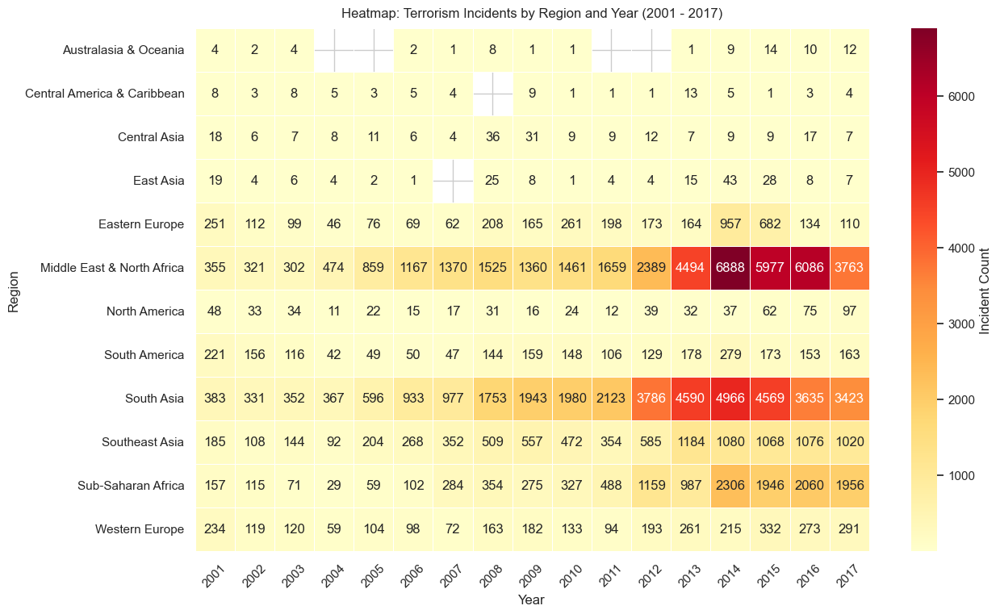

In [8]:
# Sort by years and regions of terrorism incidents
heatmap_data = new_terror_after_2000.pivot_table(index='region_txt', columns='year', values='latitude', aggfunc='count')

plt.figure(figsize=(12, 8))
sns.heatmap(heatmap_data, cmap='YlOrRd', annot=True, fmt='g', linewidths=0.5, cbar_kws={'label': 'Incident Count'})
plt.xlabel('Year')
plt.ylabel('Region')
plt.xticks(rotation=45, ha='center')
plt.title('Heatmap: Terrorism Incidents by Region and Year (2001 - 2017)', pad=10, )
plt.show()

## (1.2) Back to the original data cleaning process

In [9]:
# Count the number of incidents by country and year and add a new column, 'incident_count'
incidents_year_and_country = new_terror_after_2000.groupby(['year', 'country_txt', 'region_txt']).size().reset_index(name='incident_count')
# The difference between the above code and this code is the total 'sum' of the incident count
total_incidents_by_country = incidents_year_and_country.groupby(['country_txt', 'region_txt'])['incident_count'].sum().reset_index(name='total_incidents')
total_incidents_by_country = total_incidents_by_country.sort_values(by='total_incidents', ascending=False)

In [10]:
total_incidents_by_country.head(5)

,country_txt,region_txt,total_incidents
68,Iraq,Middle East & North Africa,24465
0,Afghanistan,South Asia,12593
109,Pakistan,South Asia,12502
64,India,South Asia,8738
114,Philippines,Southeast Asia,4788


#### (1.2.1) Plot the total incident numbers by year

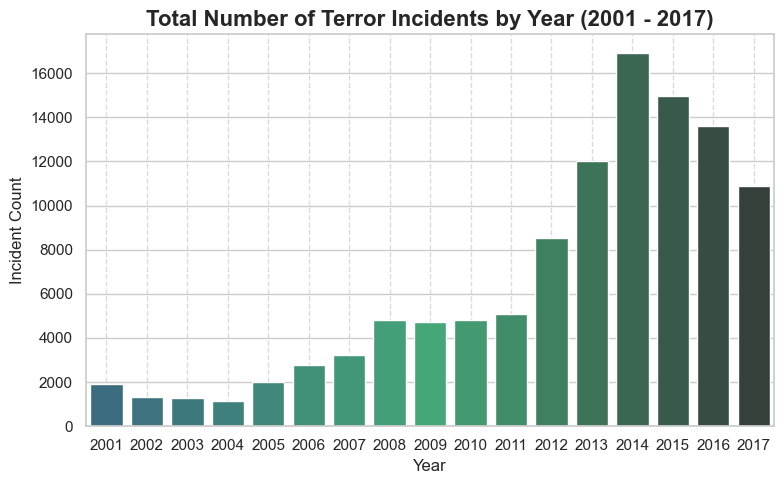

In [11]:
incidents_by_year = incidents_year_and_country.groupby('year')['incident_count'].sum().reset_index(name='sum')
incidents_by_year = incidents_by_year.sort_values(by='year', ascending=False)
incidents_by_year['year'] = incidents_by_year['year'].astype(int)
# Sort the DataFrame by 'year' in descending order
by_year = incidents_by_year.sort_values(by='year', ascending=False)
# Create the horizontal bar chart
plt.figure(figsize=(8, 5))
sns.barplot(x='year', y='sum', data=by_year, palette='viridis_d')
plt.xlabel('Year')
plt.ylabel('Incident Count')
plt.title('Total Number of Terror Incidents by Year (2001 - 2017)'
          , fontsize = 16, fontweight='bold')
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


#### (1.2.2) A pie chart with top 10 countries by incident numbers (2001 - 2017)

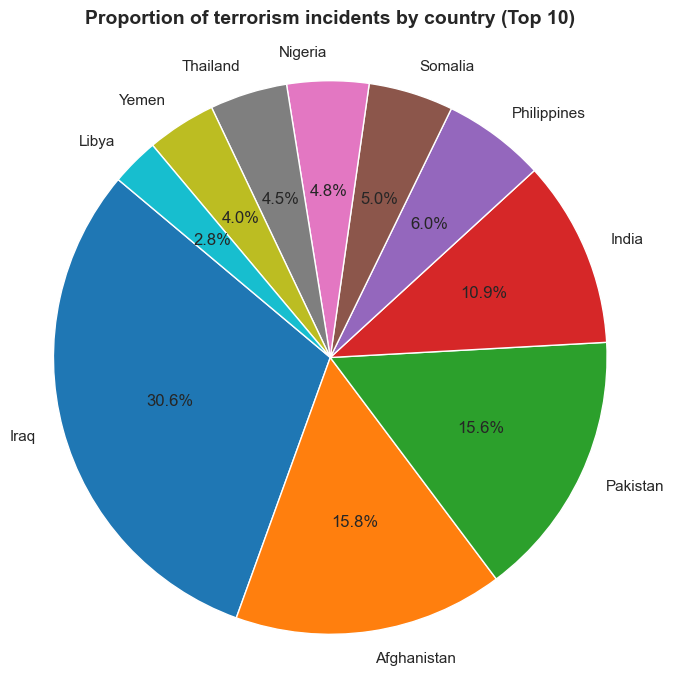

In [12]:
custom_colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']
top_countries = total_incidents_by_country.nlargest(10, 'total_incidents')
plt.figure(figsize=(7, 7))
plt.pie(top_countries['total_incidents'], labels=top_countries['country_txt'], autopct='%1.1f%%', startangle=140, colors=custom_colors)
plt.title('Proportion of terrorism incidents by country (Top 10)', fontsize = 14, fontweight='bold')
plt.axis('equal')
plt.subplots_adjust(top=1)
plt.show()

#### (1.2.3) Top 15 countries with terrorism incident

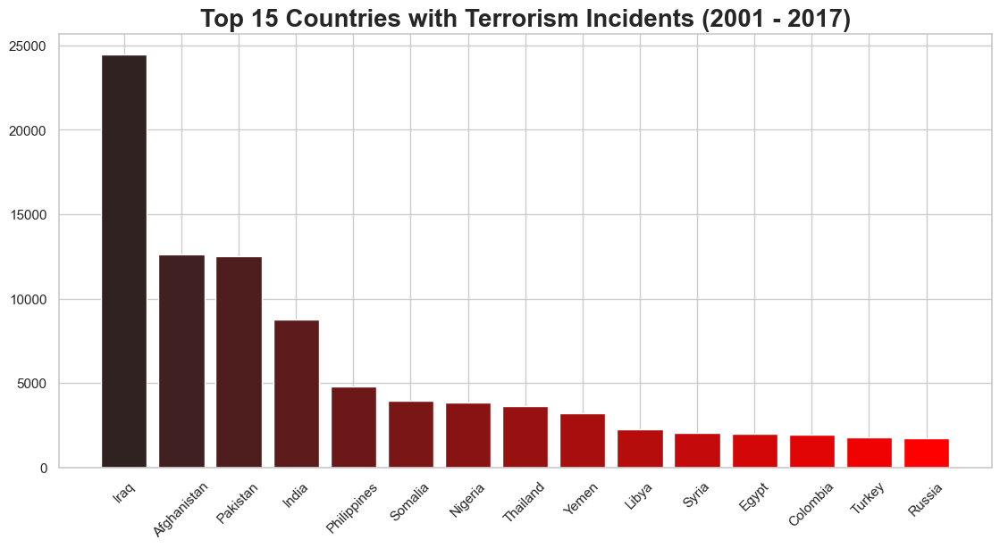

In [13]:
# Create a color palette
n_colors = 15
gradient_palette = sns.dark_palette("red", n_colors=n_colors)
# Plot the bar chart with the custom color palette
plt.figure(figsize=(12, 6))
plt.bar(total_incidents_by_country['country_txt'].head(15), total_incidents_by_country['total_incidents'].head(15), color=gradient_palette)
plt.xticks(rotation=45, ha='center')
plt.title("Top 15 Countries with Terrorism Incidents (2001 - 2017)", fontsize=20, fontweight='bold')
plt.show()

## (2) Load the second dataset: Population and GDP per capita

In [14]:
# Load the data
gdp_capita = pd.read_csv('../data/per_capita.csv')
# Filter 'Year' from 2001 to 2017 to merge with global terrorism dataset
gdp_filtered = gdp_capita[(gdp_capita['Year'] >= 2001) & (gdp_capita['Year'] <= 2017)]
gdp_filtered.drop(gdp_filtered.columns[[1, 3, 5, 7]], axis=1, inplace=True)
gdp = gdp_filtered.dropna()

In [15]:
# Check data
gdp.head(3)

,Entity,Year,GDP per capita,Population (historical estimates)
52,Afghanistan,2001,489.6820,19688634.0
53,Afghanistan,2002,796.8166,21000258.0
54,Afghanistan,2003,842.8052,22645136.0


## (2-1) Merge the second data with the first dataset

In [16]:
incident_gdp = pd.merge(incidents_year_and_country, gdp, left_on=['country_txt', 'year'], right_on=['Entity', 'Year'])
incident_gdp.drop(columns=['Entity', 'Year'], inplace=True)
# Simplify the name of population column
incident_gdp.rename(columns={'Population (historical estimates)': 'population'}, inplace=True)
# Add a new column called 'incident_per_capita (incident count / population)
incident_gdp['incident_per_capita'] = incident_gdp['incident_count'] / incident_gdp['population']
# Check the result
incident_gdp.head(2)

,year,country_txt,region_txt,incident_count,GDP per capita,population,incident_per_capita
0,2001,Afghanistan,South Asia,14,489.682,19688634.0,7.110702e-07
1,2001,Albania,Eastern Europe,1,5285.809,3153615.0,3.170964e-07


## (3) Load the last dataset: Mean education level per year

In [17]:
# Load data
education = pd.read_csv('../data/mean-years-of-schooling-long-run.csv')
# Set the timeframe from 2001 to 2017
education_after_2000 = education[(education['Year'] >= 2001) & (education['Year'] <= 2017)]
# Change a column name to short version
education_after_2000.rename(columns={
    'Average Total Years of Schooling for Adult Population (Lee-Lee (2016), Barro-Lee (2018) and UNDP (2018))': 'education_level'
}, inplace=True)
# Drop unnecessary column
education_after_2000 = education_after_2000.drop(columns='Code')
education_after_2000.head(2)

,Entity,Year,education_level
35,Afghanistan,2001,2.2
36,Afghanistan,2002,2.3


### (3-1) Merge with two other datasets

In [18]:
incident_gdp_edu = pd.merge(incident_gdp, education_after_2000, left_on=['year', 'country_txt'], right_on=['Year', 'Entity'], how='left')
incident_gdp_edu.tail(2)

,year,country_txt,region_txt,incident_count,GDP per capita,population,incident_per_capita,Entity,Year,education_level
1239,2017,Zambia,Sub-Saharan Africa,2,3497.5818,17298056.0,1.156199e-07,Zambia,2017.0,7.0
1240,2017,Zimbabwe,Sub-Saharan Africa,3,1582.3662,14751101.0,2.033746e-07,Zimbabwe,2017.0,8.2


In [19]:
# Identify missing values
incident_gdp_edu.isnull().sum()

year                    0
country_txt             0
region_txt              0
incident_count          0
GDP per capita          0
population              0
incident_per_capita     0
Entity                 17
Year                   17
education_level        17
dtype: int64

In [20]:
average_education_level = incident_gdp_edu['education_level'].mean()
incident_gdp_edu['education_level'].fillna(average_education_level, inplace=True)
incident_gdp_edu = incident_gdp_edu.drop(columns=['Entity', 'Year'])
incident_gdp_edu.tail(2)

,year,country_txt,region_txt,incident_count,GDP per capita,population,incident_per_capita,education_level
1239,2017,Zambia,Sub-Saharan Africa,2,3497.5818,17298056.0,1.156199e-07,7.0
1240,2017,Zimbabwe,Sub-Saharan Africa,3,1582.3662,14751101.0,2.033746e-07,8.2


# (4) Rename the final data set as final_data

In [21]:
final_data = incident_gdp_edu

#### (4.1) Countries with the lowest GDP

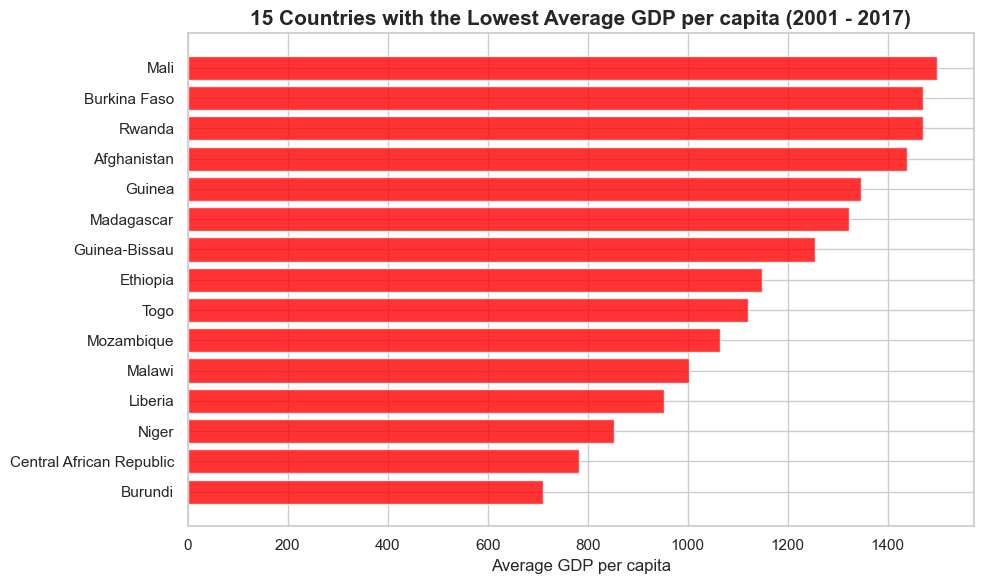

In [22]:
average_gdp_countries = final_data.groupby('country_txt')['GDP per capita'].mean().reset_index()
lowest_gdp_countries = average_gdp_countries.sort_values(by='GDP per capita', ascending=True).head(15)
plt.figure(figsize=(10, 6)) 
plt.barh(lowest_gdp_countries['country_txt'], lowest_gdp_countries['GDP per capita'], 
         color='red', alpha=0.8)
plt.xlabel('Average GDP per capita')
plt.title('15 Countries with the Lowest Average GDP per capita (2001 - 2017)', fontsize = 15, fontweight = 'bold')
plt.yticks(range(len(lowest_gdp_countries['country_txt'])), lowest_gdp_countries['country_txt'])
plt.tight_layout()
plt.show()

#### (4.2) Countries with the lowest education level

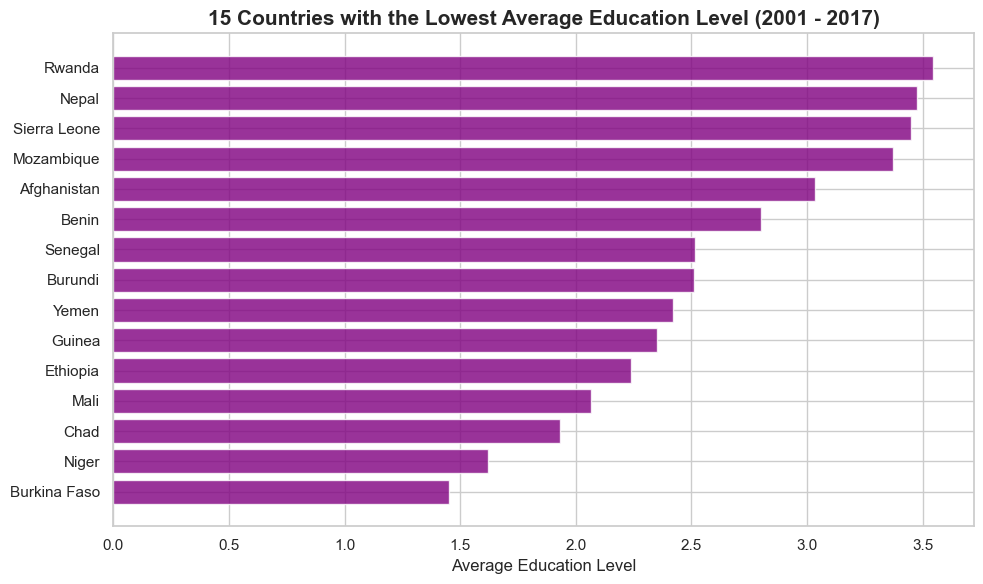

In [23]:
average_education_countries = final_data.groupby('country_txt')['education_level'].mean().reset_index()
lowest_education_countries = average_education_countries.sort_values(by='education_level', ascending=True).head(15)

plt.figure(figsize=(10, 6)) 
plt.barh(lowest_education_countries['country_txt'], lowest_education_countries['education_level'], 
         color='purple', alpha=0.8)
plt.xlabel('Average Education Level')
plt.title('15 Countries with the Lowest Average Education Level (2001 - 2017)', fontsize=15, fontweight='bold')
plt.yticks(range(len(lowest_education_countries['country_txt'])), lowest_education_countries['country_txt'])
plt.tight_layout()
plt.show()

#### (4.3) Create a heatmap shows the education level by region

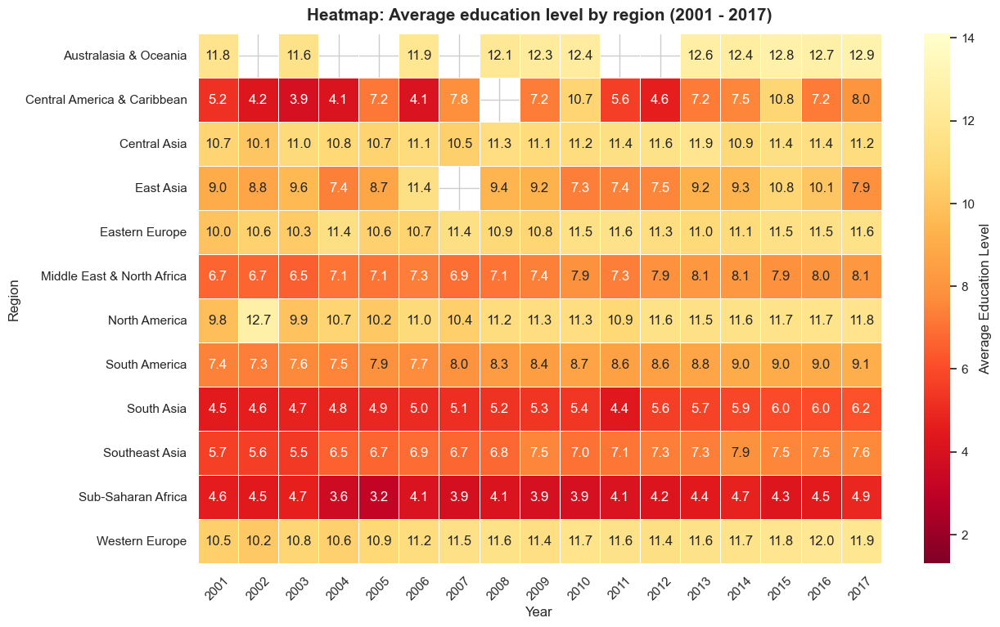

In [24]:
heatmap_data = final_data.pivot_table(index='region_txt', columns='year', values='education_level', aggfunc='mean')

plt.figure(figsize=(12, 8))
sns.heatmap(heatmap_data, cmap='YlOrRd_r', annot=True, fmt='.1f', linewidths=0.5, cbar_kws={'label': 'Average Education Level'}, vmin=final_data['education_level'].min(), vmax=final_data['education_level'].max())
plt.xlabel('Year')
plt.ylabel('Region')
plt.xticks(rotation=45, ha='center')
plt.title('Heatmap: Average education level by region (2001 - 2017)', pad=12, fontsize=15, fontweight='bold')
plt.show()


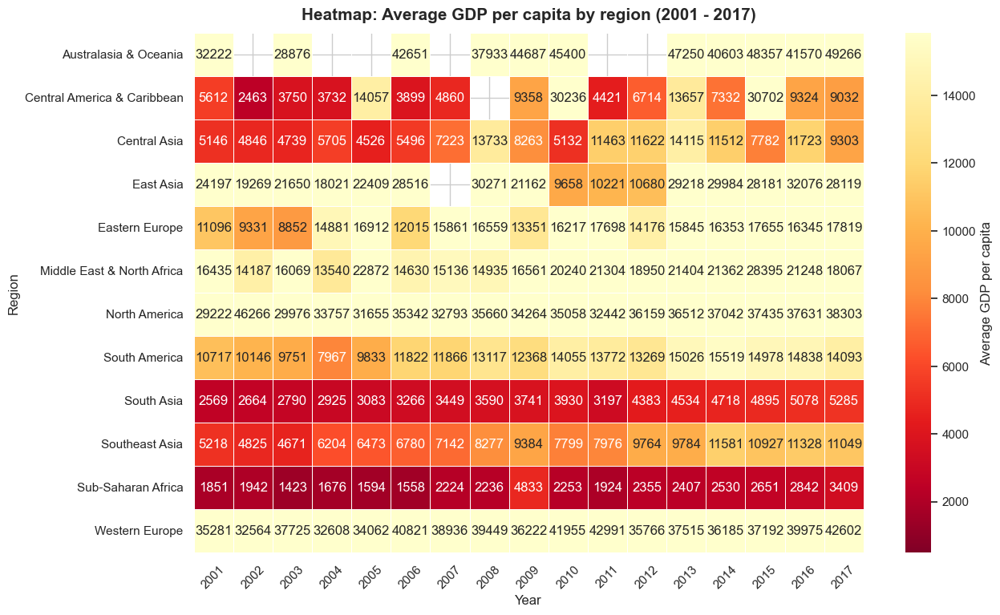

In [25]:
heatmap_data = final_data.pivot_table(index='region_txt', columns='year', values='GDP per capita', aggfunc='mean')

plt.figure(figsize=(12, 8))
sns.heatmap(heatmap_data, cmap='YlOrRd_r', annot=True, fmt='.0f', linewidths=0.5, cbar_kws={'label': 'Average GDP per capita'}, vmin=final_data['GDP per capita'].min(), vmax=final_data['GDP per capita'].mean())
plt.xlabel('Year')
plt.ylabel('Region')
plt.xticks(rotation=45, ha='center')
plt.title('Heatmap: Average GDP per capita by region (2001 - 2017)', pad=12, fontsize=15, fontweight='bold')
plt.show()


#### (4.5) Distribution features

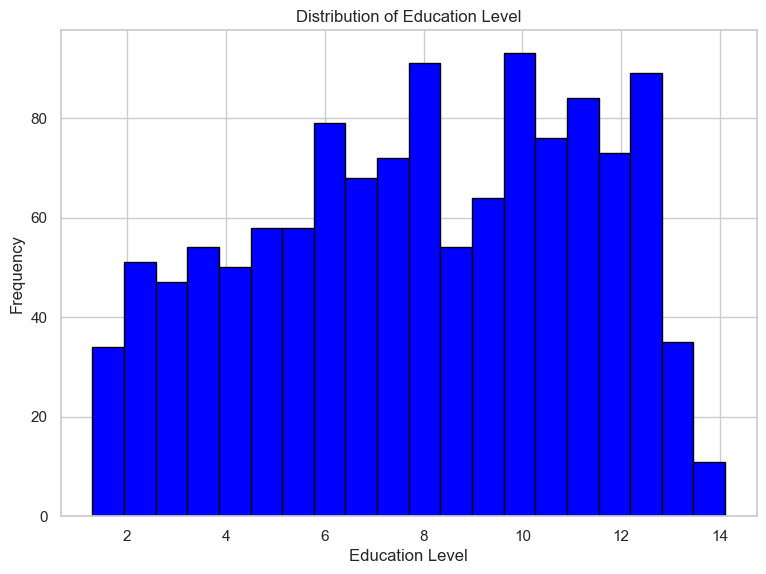

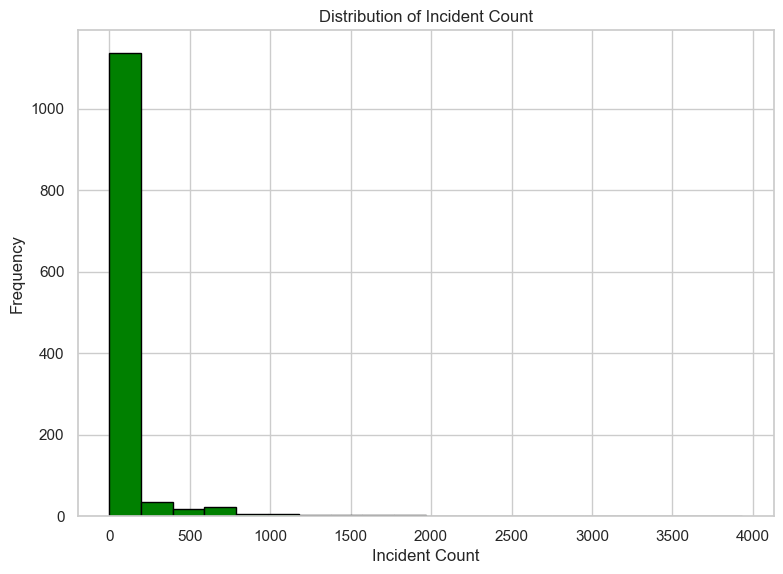

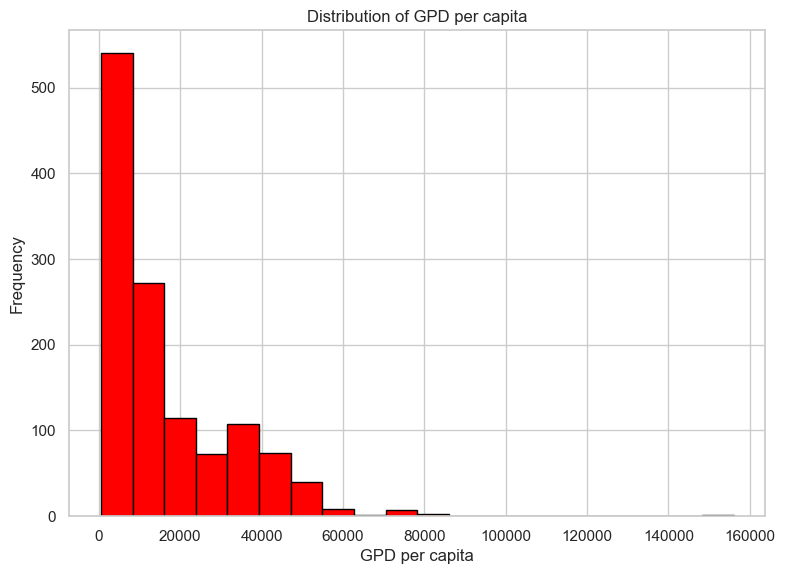

In [26]:
education_level_cleaned = final_data['education_level']
incident_count_cleaned = final_data['incident_count']
gdp_cleaned = final_data['GDP per capita']

plt.figure(figsize=(8, 6))
plt.hist(education_level_cleaned, bins=20, color='blue', edgecolor='black')
plt.xlabel('Education Level')
plt.ylabel('Frequency')
plt.title('Distribution of Education Level')
plt.grid(True)
plt.show()

plt.figure(figsize=(8, 6))
plt.hist(incident_count_cleaned, bins=20, color='green', edgecolor='black')
plt.xlabel('Incident Count')
plt.ylabel('Frequency')
plt.title('Distribution of Incident Count')
plt.grid(True)
plt.show()

plt.figure(figsize=(8, 6))
plt.hist(gdp_cleaned, bins=20, color='red', edgecolor='black')
plt.xlabel('GPD per capita')
plt.ylabel('Frequency')
plt.title('Distribution of GPD per capita')
plt.grid(True)
plt.show()

#### (4.6) Pairplots between three variables

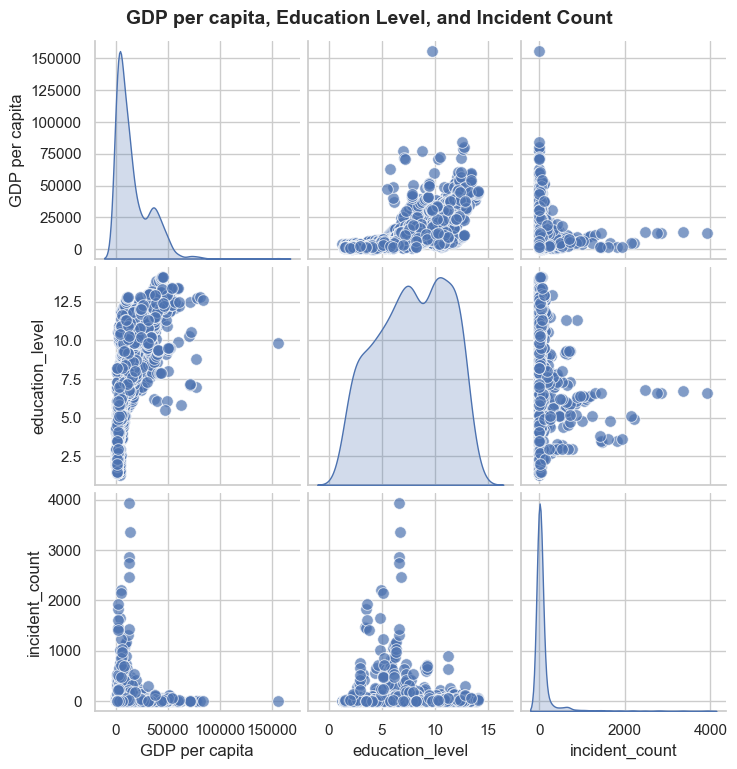

In [27]:
variables = ['GDP per capita', 'education_level', 'incident_count']
sns.set(style='whitegrid')

sns.pairplot(final_data[variables], diag_kind='kde', plot_kws={'alpha': 0.7, 's': 70})
plt.suptitle('GDP per capita, Education Level, and Incident Count', fontsize=14, fontweight='bold', y=1.02)
plt.show()

## (5) Plot overview

### (5.1) Education level and incident count

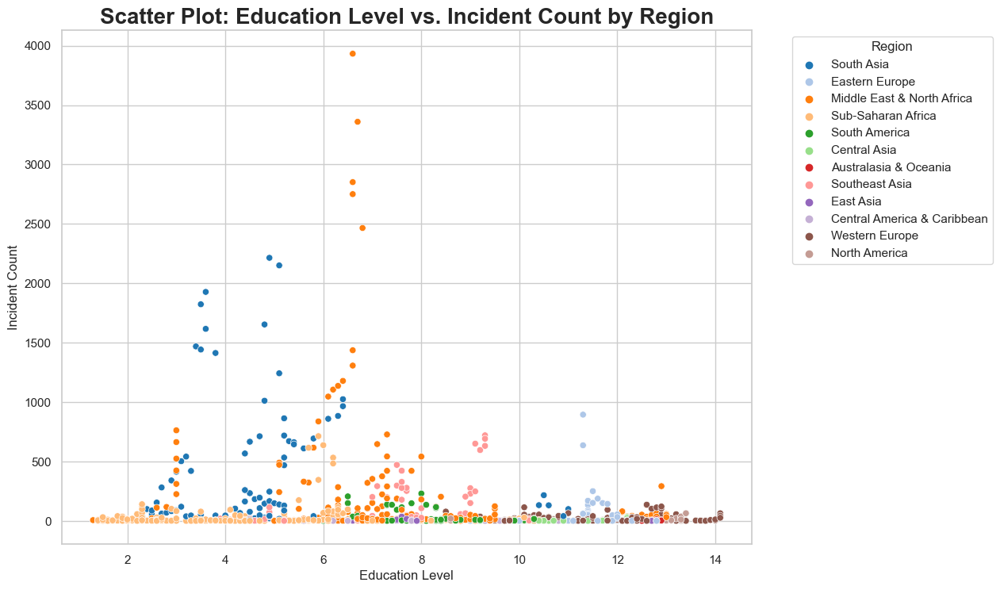

In [28]:
education_level_cleaned = final_data['education_level']
incident_count_cleaned = final_data['incident_count']
gdp_count_cleaned = final_data['GDP per capita']
region_txt = final_data['region_txt']

plt.figure(figsize=(10, 8))
sns.scatterplot(x=final_data['education_level'], y=incident_count_cleaned, hue=region_txt, palette='tab20')
plt.xlabel('Education Level')
plt.ylabel('Incident Count')
plt.title('Scatter Plot: Education Level vs. Incident Count by Region', fontsize=20, fontweight='bold')
plt.grid(True)
plt.legend(title='Region', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

### (5.2) GDP per capita and incident count

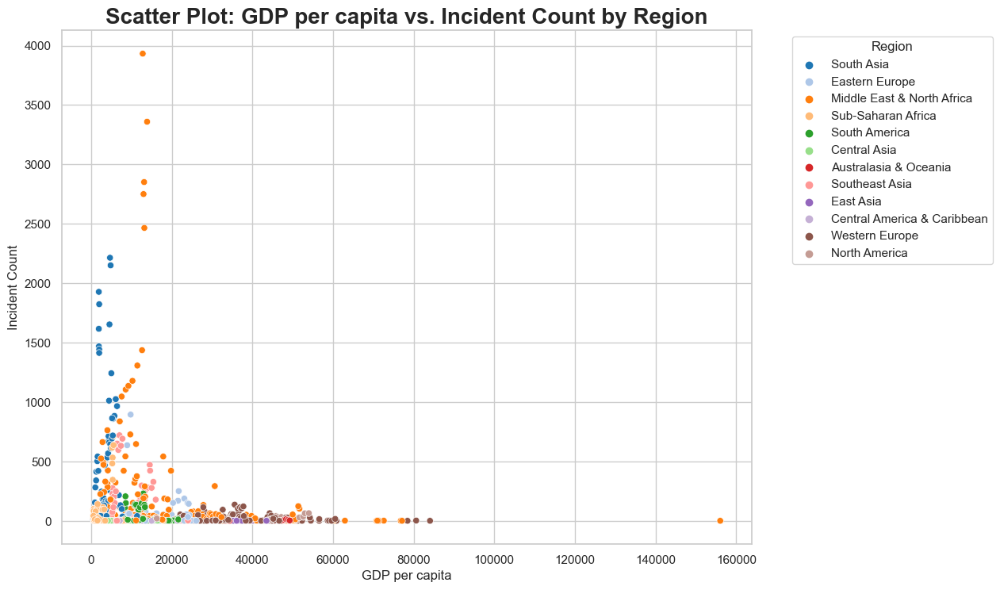

In [29]:
plt.figure(figsize=(10, 8))
sns.scatterplot(x=final_data['GDP per capita'], y=incident_count_cleaned, hue=region_txt, palette='tab20')
plt.xlabel('GDP per capita')
plt.ylabel('Incident Count')
plt.title('Scatter Plot: GDP per capita vs. Incident Count by Region', fontsize=20, fontweight='bold')
plt.grid(True)
plt.legend(title='Region', bbox_to_anchor=(1.05, 1), loc='upper left')

plt.show()

## (6) Hypothesis testing 
* Null Hypothesis (H0): Lack of education in developing countries has no significant relationship with participation in violent extremist activities.
* Alternative Hypothesis (H1): Lack of education in developing countries significantly relates to participation in violent extremist activities.

* Objectives: Determine whether the model is statistically significant and whether at least one independent variable significantly impacts the dependent variable.

### (6.1) Correlation heatmap with all features

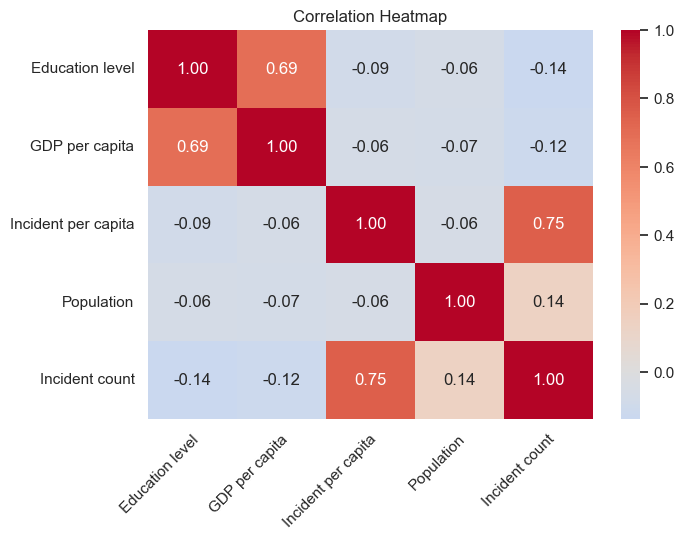

In [30]:
correlation_matrix = final_data[['education_level', 'GDP per capita', 'incident_per_capita', 'population', 'incident_count']].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0, fmt='.2f')
plt.title('Correlation Heatmap')
labels = ['Education level', 'GDP per capita', 'Incident per capita', 'Population', 'Incident count']
plt.xticks(ticks=[0.6,1.6,2.6,3.6,4.6], labels=labels, rotation=45, ha='right')
plt.yticks(ticks=[0.5,1.5,2.5,3.5,4.5], labels=labels, ha='right')
plt.show()

### (6.2) Correlation heatmap with main features

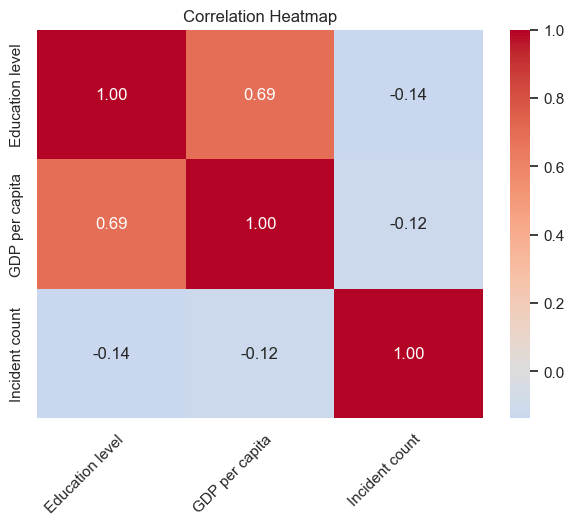

In [31]:
correlation_matrix2 = final_data[['education_level', 'GDP per capita', 'incident_count']].corr()
sns.heatmap(correlation_matrix2, annot=True, cmap='coolwarm', center=0, fmt='.2f')
plt.title('Correlation Heatmap')
labels = ['Education level', 'GDP per capita', 'Incident count']
plt.xticks(ticks=[0.6,1.6,2.6], labels=labels, rotation=45, ha='right')
plt.yticks(ticks=[0.5,1.5,2.5], labels=labels, ha='right')
plt.show()

Correlation analysis explanation
- Positive correlation between 'education_level' and 'GDP per capita' (correlation coefficient: 0.693)
- Negative correlation between 'education_level' and 'incident_count' (correlation coefficient: -0.138)
- The correlation between 'GDP per capita' and 'incident_count' is weak (correlation coefficient: -0.119)

Find coefficients between features and the target

In [32]:
X = final_data[['education_level', 'GDP per capita']]
y = final_data['incident_count']
# Create the linear regression model
model = LinearRegression()
# Fit the model with the data
model.fit(X, y)
# Get the coefficients
coefficients = model.coef_
intercept = model.intercept_
# Print the coefficients
print('Coefficients:', coefficients)
print('Intercept:', intercept)

Coefficients: [-9.26509445e+00 -8.33768661e-04]
Intercept: 169.07140109492713


For 'education_level': The coefficient is approximately -9.265.
For 'GDP per capita': The coefficient is approximately -0.000833. 

Find mean and median values for the further analysis


In [33]:
# Mean & median total incident by country
mean_incidents_by_country = total_incidents_by_country['total_incidents'].mean()
median_incident_by_country = total_incidents_by_country['total_incidents'].median()
print(f"Average number of terrorism incidents from 2001 to 2017 by country:", mean_incidents_by_country)
print(f"Media number of terrorism incidents from 2001 to 2017 by country:", median_incident_by_country)
# Mean totalincident by year
mean_incident_by_year = incidents_year_and_country['incident_count'].mean()
median_incident_by_year = incidents_year_and_country['incident_count'].median()
print(f"Average number of terrorism incidents from 2001 to 2017 by year:", mean_incident_by_year)
print(f"Median number of terrorism incidents from 2001 to 2017 by year:", median_incident_by_year)


Average number of terrorism incidents from 2001 to 2017 by country: 670.9817073170732
Media number of terrorism incidents from 2001 to 2017 by country: 23.0
Average number of terrorism incidents from 2001 to 2017 by year: 76.84427374301676
Median number of terrorism incidents from 2001 to 2017 by year: 5.0


## (6.3) Linear regression model between GDP per capita and incident count

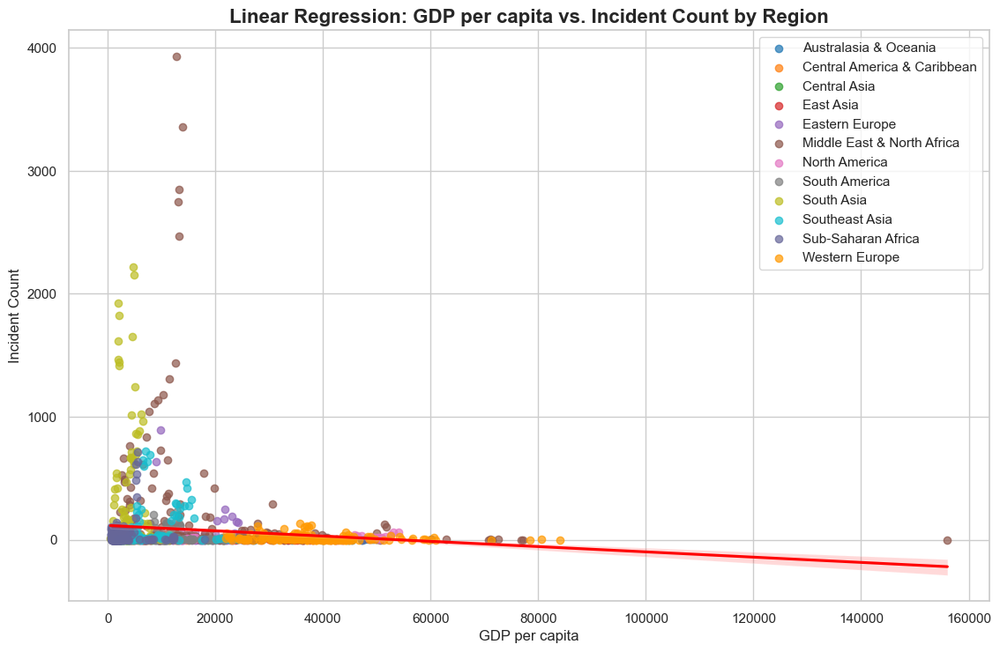

In [34]:
# Linear regression "GDP per capita" and "incident_count"
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd',
                 '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf',
                 '#666699', '#ff9900']
# Groupby 'region_txt'
selected_data = final_data.groupby('region_txt')
# Scatter plot by regions
plt.figure(figsize=(12, 8))
for i, (region, group) in enumerate(selected_data):
    GDP_per_capita = group['GDP per capita']
    incident_count = group['incident_count']
    plt.scatter(GDP_per_capita, incident_count, alpha=0.7, label=region, color=colors[i])
# Draw Regression line
sns.regplot(x=final_data['GDP per capita'], y=final_data['incident_count'], scatter=False, color='red')
plt.xlabel('GDP per capita')
plt.ylabel('Incident Count')
plt.title('Linear Regression: GDP per capita vs. Incident Count by Region', fontsize = 16, fontweight='bold')
plt.legend()
plt.grid(True)
plt.show()

## (6.4) Linear regression model between education level and incident count

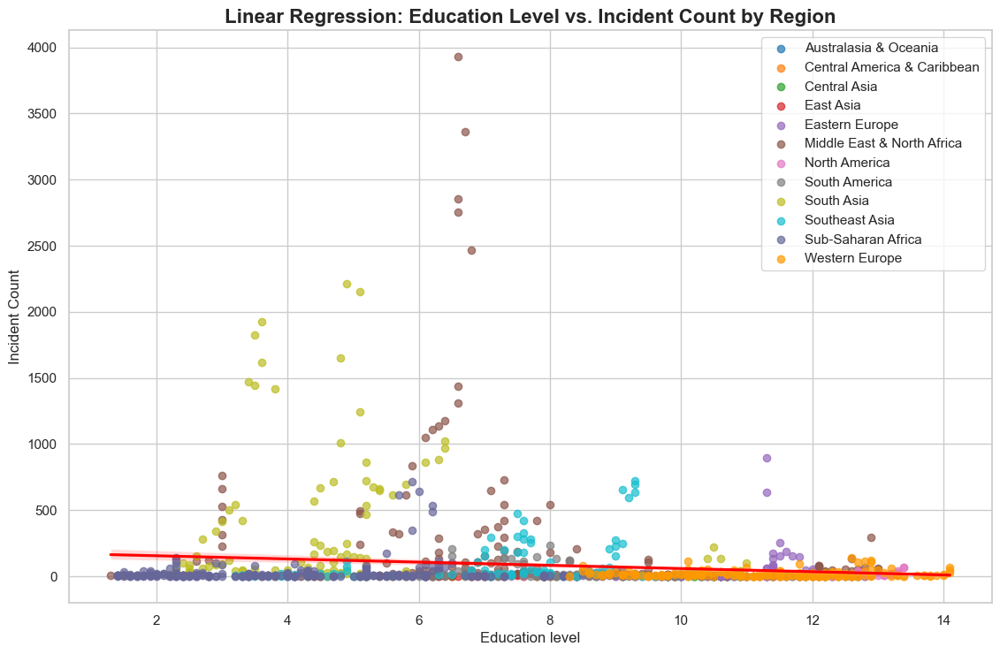

In [35]:
# Linear regression "GDP per capita" and "incident_count"
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd',
                 '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf',
                 '#666699', '#ff9900']
selected_data = final_data.groupby('region_txt')
# Scatter plot by regions
plt.figure(figsize=(12, 8))
for i, (region, group) in enumerate(selected_data):
    education_level = group['education_level']
    incident_count = group['incident_count']
    plt.scatter(education_level, incident_count, alpha=0.7, label=region, color=colors[i])
# Regression line
sns.regplot(x=final_data['education_level'], y=final_data['incident_count'], scatter=False, color='red')
plt.xlabel('Education level')
plt.ylabel('Incident Count')
plt.title('Linear Regression: Education Level vs. Incident Count by Region', fontsize = 16, fontweight='bold')
plt.legend()
plt.grid(True)
plt.show()

## (6.5) OLS regression calculation

Ordinary Least Squares (OLS) regression results with education level and GDP per capita

In [36]:
import statsmodels.api as sm

# Define independent & dependent variable
X = final_data[['education_level', 'GDP per capita']]
y = final_data['incident_count']

# Add a constant column to X
X = sm.add_constant(X)

# Fit the multiple linear regression model
model = sm.OLS(y, X).fit()

# Print the summary
print(model.summary())


                            OLS Regression Results                            
Dep. Variable:         incident_count   R-squared:                       0.020
Model:                            OLS   Adj. R-squared:                  0.018
Method:                 Least Squares   F-statistic:                     12.64
Date:                Wed, 09 Aug 2023   Prob (F-statistic):           3.67e-06
Time:                        22:40:04   Log-Likelihood:                -8783.7
No. Observations:                1241   AIC:                         1.757e+04
Df Residuals:                    1238   BIC:                         1.759e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const             169.0714     22.420     

The result: 
- R-squared: 0.052, approximately 5.2% of the variance in incident_count is explained by the two independent variables in the model.
- F-statistic: 34.01. The associated p-value (Prob (F-statistic)) is low (4.19e-15), which indiciates that there is a significant relationship between the independent variables and the dependent variable.

Although, multiple factors suggest that there are relationships between independent and dependent variables, the low R-squared score indicate that that are other factors contribute to the variation in incident count.

Check residuals and QQ plots

## (6.6) Residual plots

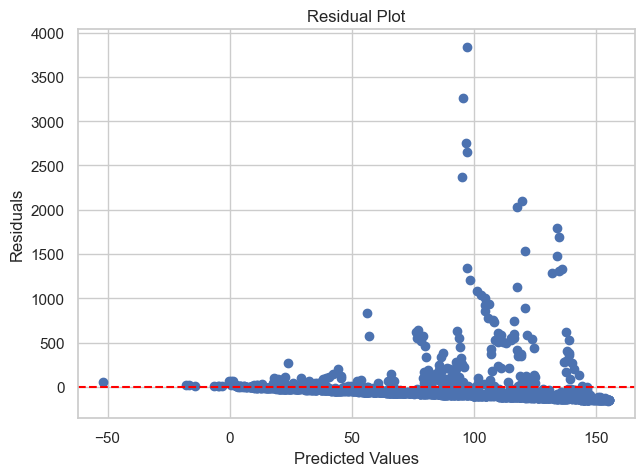

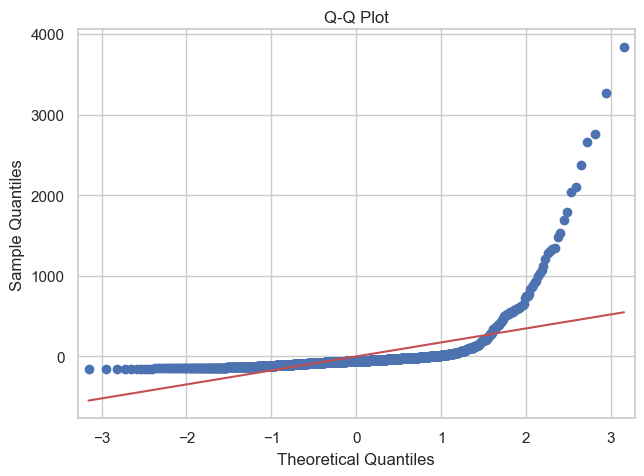

                            OLS Regression Results                            
Dep. Variable:         incident_count   R-squared:                       0.020
Model:                            OLS   Adj. R-squared:                  0.018
Method:                 Least Squares   F-statistic:                     12.64
Date:                Wed, 09 Aug 2023   Prob (F-statistic):           3.67e-06
Time:                        22:40:05   Log-Likelihood:                -8783.7
No. Observations:                1241   AIC:                         1.757e+04
Df Residuals:                    1238   BIC:                         1.759e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const             169.0714     22.420     

In [37]:
X = final_data[['education_level', 'GDP per capita']]
y = final_data['incident_count']

# Fit the multiple linear regression model with adding constant
X = sm.add_constant(X)  
model = sm.OLS(y, X).fit()
# Check Assumptions
# Residual Plot
residuals = model.resid
plt.scatter(model.predict(), residuals)
plt.xlabel("Predicted Values")
plt.ylabel("Residuals")
plt.title("Residual Plot")
plt.axhline(y=0, color='red', linestyle='--')
plt.show()
# Q-Q Plot
sm.qqplot(residuals, line='r')
plt.title("Q-Q Plot")
plt.show()
# Hypothesis Testing
print(model.summary())


## (6.7) T-test

What is the T-test? (sample vs. population)
- It determines the sample data and its ability to provide valuable insights about the population. 
- If the p-value is more significant than 0.05, it fails to reject the null hypothesis. In other words, there is insufficient evidence to conclude that the sample mean significantly differs from the hypothesized population mean.

#### (6.7.1) T-Test between different regions

In [38]:
# Separate by 'region' data from the population
sub_sahara_education_data = final_data[final_data['region_txt'] == 'Sub-Saharan Africa']['education_level']
mena_education_data = final_data[final_data['region_txt'] == 'Middle East & North Africa']['education_level']
western_europe_education_data = final_data[final_data['region_txt'] == 'Western Europe']['education_level']
south_america_education_data = final_data[final_data['region_txt'] == 'South America']['education_level']
north_america_education_data = final_data[final_data['region_txt'] == 'North America']['education_level']
south_asia_education_data = final_data[final_data['region_txt'] == 'South Asia']['education_level']
southeast_asia_education_data = final_data[final_data['region_txt'] == 'Southeast Asia']['education_level']
central_asia_education_data = final_data[final_data['region_txt'] == 'Central Asia']['education_level']
eastern_europe_education_data = final_data[final_data['region_txt'] == 'Eastern Europe']['education_level']
caribbean_education_data = final_data[final_data['region_txt'] == 'Central America & Caribbean']['education_level']
oceania_education_data = final_data[final_data['region_txt'] == 'Australasia & Oceania']['education_level']
# Select the sample size
sample_size = 300
# Create the sample variables
sample_edu_sub_sahara= np.random.choice(sub_sahara_education_data, size=sample_size)
sample_edu_mena = np.random.choice(mena_education_data, size=sample_size)
sample_edu_western_europe = np.random.choice(western_europe_education_data, size=sample_size)
sampe_edu_south_america = np.random.choice(south_america_education_data, size=sample_size)
sampe_edu_north_america = np.random.choice(north_america_education_data, size=sample_size)
sample_edu_south_asia = np.random.choice(south_asia_education_data, size=sample_size)
sample_edu_southeast_asia = np.random.choice(southeast_asia_education_data, size=sample_size)
sample_edu_central_asia = np.random.choice(central_asia_education_data, size=sample_size)
sample_edu_eastern_europe = np.random.choice(eastern_europe_education_data, size=sample_size)
sample_edu_western_europe = np.random.choice(western_europe_education_data, size=sample_size)
sample_edu_caribbean = np.random.choice(caribbean_education_data, size=sample_size)
sample_edu_oceania = np.random.choice(oceania_education_data, size=sample_size)
# Perform the t-test between two regions 
t_statistic, p_value = stats.ttest_ind(south_asia_education_data, sub_sahara_education_data)
# Print the results
print("T-Statistic:", t_statistic)
print("P-Value:", p_value)

T-Statistic: 3.9357276309263742
P-Value: 9.98115444149095e-05


### (6.7.2) T-test in graphic

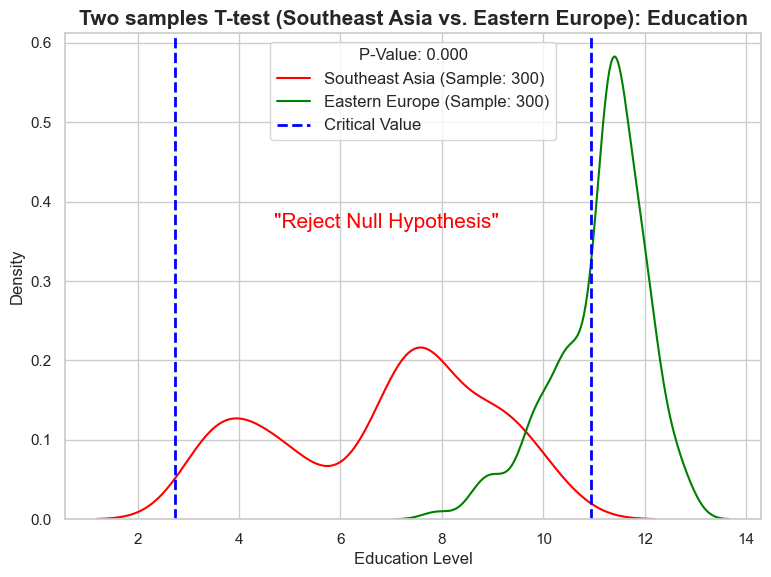

p_value is 3.208509222904681e-135
t_statistic is -32.69126804335088


In [39]:
# Find critical values 
sasia_edu = norm.fit(sample_edu_southeast_asia)
sasia_edu_distribution = norm(loc=np.mean(sample_edu_southeast_asia), scale=np.std(sample_edu_southeast_asia, ddof=1))
eu_edu_distribution = norm(loc=np.mean(sample_edu_eastern_europe), scale=np.std(sample_edu_eastern_europe, ddof=1))
critical_value = sasia_edu_distribution.ppf(0.025)
critical_value2 = sasia_edu_distribution.ppf(0.975)
# Region vs. region samples t-test
plt.figure(figsize=(8, 6))
# Plot the KDE plots for the two samples
sns.kdeplot(sample_edu_southeast_asia, color='red', label='Southeast Asia (Sample: 300)')
sns.kdeplot(sample_edu_eastern_europe, color='green', label='Eastern Europe (Sample: 300)')
plt.xlabel('Education Level')
plt.ylabel('Density')
plt.title('Two samples T-test (Southeast Asia vs. Eastern Europe): Education', fontsize = 15, fontweight='bold')
t_statistic, p_value = stats.ttest_ind(sample_edu_southeast_asia, sample_edu_eastern_europe)
plt.axvline(critical_value, color='blue', linestyle='dashed', linewidth=2, label=f'Critical Value')
plt.axvline(critical_value2, color='blue', linestyle='dashed', linewidth=2)
# Add a legend with the p-value
plt.legend(title=f"P-Value: {p_value:.3f}", loc='upper center', fontsize=12)
# Compare the p-value with the significance level 
alpha = 0.05
if p_value < alpha:
    # Reject the null hypothesis
    plt.annotate('"Reject Null Hypothesis"', xy=(0.3, 0.6), xycoords='axes fraction', fontsize=15, color='red')
else:
    # Fail to reject the null hypothesis
    plt.annotate('"Fail to Reject Null Hypothesis"', xy=(0.3, 0.6), xycoords='axes fraction', fontsize=15, color='green')
plt.show()

print("p_value is", p_value)
print("t_statistic is", t_statistic)

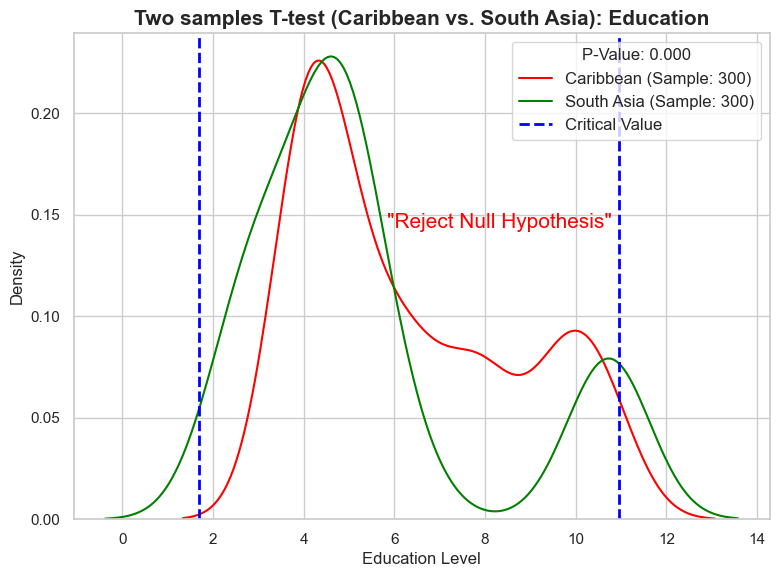

9.408244154725792e-06


In [40]:
# Find critical values 
car_edu = norm.fit(sample_edu_caribbean)
car_distribution = norm(loc=np.mean(sample_edu_caribbean), scale=np.std(sample_edu_caribbean, ddof=1))
sasia_distribution = norm(loc=np.mean(sample_edu_south_asia), scale=np.std(sample_edu_south_asia, ddof=1))
critical_value = car_distribution.ppf(0.025)
critical_value2 = car_distribution.ppf(0.975)
# Region vs. region samples t-test
plt.figure(figsize=(8, 6))
# Plot the KDE plots for the two samples
sns.kdeplot(sample_edu_caribbean, color='red', label='Caribbean (Sample: 300)')
sns.kdeplot(sample_edu_south_asia, color='green', label='South Asia (Sample: 300)')
plt.xlabel('Education Level')
plt.ylabel('Density')
plt.title('Two samples T-test (Caribbean vs. South Asia): Education', fontsize = 15, fontweight='bold')
t_statistic, p_value = stats.ttest_ind(sample_edu_caribbean, sample_edu_south_asia, equal_var=True)
plt.axvline(critical_value, color='blue', linestyle='dashed', linewidth=2, label=f'Critical Value')
plt.axvline(critical_value2, color='blue', linestyle='dashed', linewidth=2)
# Add a legend with the p-value
plt.legend(title=f"P-Value: {p_value:.3f}", loc='upper right', fontsize=12)
# Compare the p-value with the significance level 
alpha = 0.05
if p_value < alpha:
    # Reject the null hypothesis
    plt.annotate('"Reject Null Hypothesis"', xy=(0.45, 0.6), xycoords='axes fraction', fontsize=15, color='red')
else:
    # Fail to reject the null hypothesis
    plt.annotate('"Fail to Reject Null Hypothesis"', xy=(0.65, 0.6), xycoords='axes fraction', fontsize=15, color='green')
plt.show()

print(p_value)

## Bootstrap t-test between Carribean and South Asia - Education level

In [214]:
caribbean_education_data = final_data[final_data['region_txt'] == 'Central America & Caribbean']['education_level']
south_asia_education_data = final_data[final_data['region_txt'] == 'South Asia']['education_level']

# Find mean and std values from the selected sample group
caribbean_education_mean = np.mean(caribbean_education_data)
caribbean_education_std = np.std(caribbean_education_data)
south_asia_education_mean = np.mean(south_asia_education_data)
south_asia_education_std = np.std(south_asia_education_data)
# Normalization
caribbean_education_normalized = (caribbean_education_data - caribbean_education_mean) / caribbean_education_std
south_asia_education_normalized = (south_asia_education_data - south_asia_education_mean) / south_asia_education_std
# Number of bootstrap samples
num_bootstrap_samples = 1000
# Bootstrap_samples function
def bootstrap_samples(x, num_bootstrap_samples):
    bootstrap_samples = []
    for _ in range(num_bootstrap_samples):
        bootstrap_samples.append(np.mean(np.random.choice(x.squeeze(), size=len(x), replace=True)))
    return bootstrap_samples
# Apply function
caribbean_education_bootstrap = bootstrap_samples(caribbean_education_normalized, num_bootstrap_samples)
south_asia_education_bootstrap = bootstrap_samples(south_asia_education_normalized, num_bootstrap_samples)



In [221]:
# mil_distribution = norm(loc=np.mean(practice_mil), scale=np.std(practice_mil)/(len(practice_mil)))
caribbean_education_distribution = norm(loc=np.mean(caribbean_education_bootstrap), scale=np.std(caribbean_education_bootstrap, ddof=1))
# civ_distribution = norm(loc=np.mean(practice_civ), scale=np.std(practice_civ)/(len(practice_civ)))
south_asia_education_distribution = norm(loc=np.mean(south_asia_education_bootstrap), scale=np.std(south_asia_education_bootstrap, ddof=1))
# critical_value_edu_caribbean_south_asia = caribbean_education_bootstrap.ppf(0.025)
# critical_value_edu_caribbean_south_asia2 = caribbean_education_bootstrap.ppf(0.975)
alpha = 0.025
critical_value_edu_caribbean_south_asia = np.percentile(caribbean_education_bootstrap, alpha * 100)
critical_value_edu_caribbean_south_asia2 = np.percentile(caribbean_education_bootstrap, (1 - alpha) * 100)
# critical_value = null_distribution.ppf(0.95)

print(critical_value_edu_caribbean_south_asia, critical_value_edu_caribbean_south_asia2)

-0.33397668803154984 0.32294641748071873


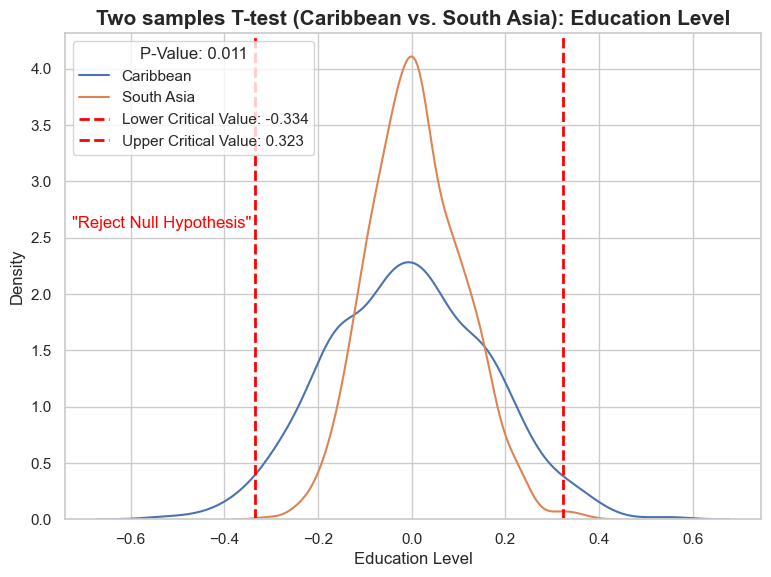

In [224]:
# Perform t-test
t_stat, p_value_ttest = ttest_ind(caribbean_education_data, south_asia_education_data)
# KDE plots
plt.figure(figsize=(8,6))
sns.set(style='whitegrid')
sns.kdeplot(caribbean_education_bootstrap, label='Caribbean')
sns.kdeplot(south_asia_education_bootstrap, label='South Asia')
plt.axvline(critical_value_edu_caribbean_south_asia, color='red', linestyle='dashed', linewidth=2, label=f'Lower Critical Value: {critical_value_edu_caribbean_south_asia:.3f}')
plt.axvline(critical_value_edu_caribbean_south_asia2, color='red', linestyle='dashed', linewidth=2, label=f'Upper Critical Value: {critical_value_edu_caribbean_south_asia2:.3f}')
plt.xlabel('Education Level')
plt.ylabel('Density')
plt.title('Two samples T-test (Caribbean vs. South Asia): Education Level', fontsize = 15, fontweight='bold')
plt.legend(title=f"P-Value: {p_value_ttest:.3f}", loc='upper left')

alpha = 0.05
if p_value_ttest < alpha:
    # Reject the null hypothesis
    plt.annotate('"Reject Null Hypothesis"', xy=(0.01, 0.6), xycoords='axes fraction', fontsize=12, color='red')
else:
    # Fail to reject the null hypothesis
    plt.annotate('"Fail to Reject Null Hypothesis"', xy=(0.01, 0.6), xycoords='axes fraction', fontsize=12, color='green')
plt.show()

### (6.7.3) Sample by GDP per capita

In [41]:
# Separate by 'region' data from the population
sub_sahara_gdp_data = final_data[final_data['region_txt'] == 'Sub-Saharan Africa']['GDP per capita']
mena_gdp_data = final_data[final_data['region_txt'] == 'Middle East & North Africa']['GDP per capita']
western_europe_gdp_data = final_data[final_data['region_txt'] == 'Western Europe']['GDP per capita']
south_america_gdp_data = final_data[final_data['region_txt'] == 'South America']['GDP per capita']
north_america_gdp_data = final_data[final_data['region_txt'] == 'North America']['GDP per capita']
south_asia_gdp_data = final_data[final_data['region_txt'] == 'South Asia']['GDP per capita']
southeast_asia_gdp_data = final_data[final_data['region_txt'] == 'Southeast Asia']['GDP per capita']
central_asia_gdp_data = final_data[final_data['region_txt'] == 'Central Asia']['GDP per capita']
eastern_europe_gdp_data = final_data[final_data['region_txt'] == 'Eastern Europe']['GDP per capita']
caribbean_gdp_data = final_data[final_data['region_txt'] == 'Central America & Caribbean']['GDP per capita']
oceania_gdp_data = final_data[final_data['region_txt'] == 'Australasia & Oceania']['GDP per capita']
# Select the sample size
sample_size = 300
# Create the sample variables
sample_gdp_sub_sahara= np.random.choice(sub_sahara_gdp_data, size=sample_size)
sample_gdp_mena = np.random.choice(mena_gdp_data, size=sample_size)
sample_gdp_western_europe = np.random.choice(western_europe_gdp_data, size=sample_size)
sample_gdp_south_america = np.random.choice(south_america_gdp_data, size=sample_size)
sample_gdp_north_america = np.random.choice(north_america_gdp_data, size=sample_size)
sample_gdp_south_asia = np.random.choice(south_asia_gdp_data, size=sample_size)
sample_gdp_southeast_asia = np.random.choice(southeast_asia_gdp_data, size=sample_size)
sample_gdp_central_asia = np.random.choice(central_asia_gdp_data, size=sample_size)
sample_gdp_eastern_europe = np.random.choice(eastern_europe_gdp_data, size=sample_size)
sample_gdp_western_europe = np.random.choice(western_europe_gdp_data, size=sample_size)
sample_gdp_caribbean = np.random.choice(caribbean_gdp_data, size=sample_size)
sample_gdp_oceania = np.random.choice(oceania_gdp_data, size=sample_size)
# Perform the t-test between two regions 
t_statistic_gdp, p_value_gdp = stats.ttest_ind(southeast_asia_gdp_data, sample_gdp_sub_sahara)
# Print the results
print("T-Statistic:", t_statistic_gdp)
print("P-Value:", p_value_gdp)

T-Statistic: 10.436430199321888
P-Value: 1.2214894479807446e-22


### (6.7.4) Sample by GDP per capita with graph

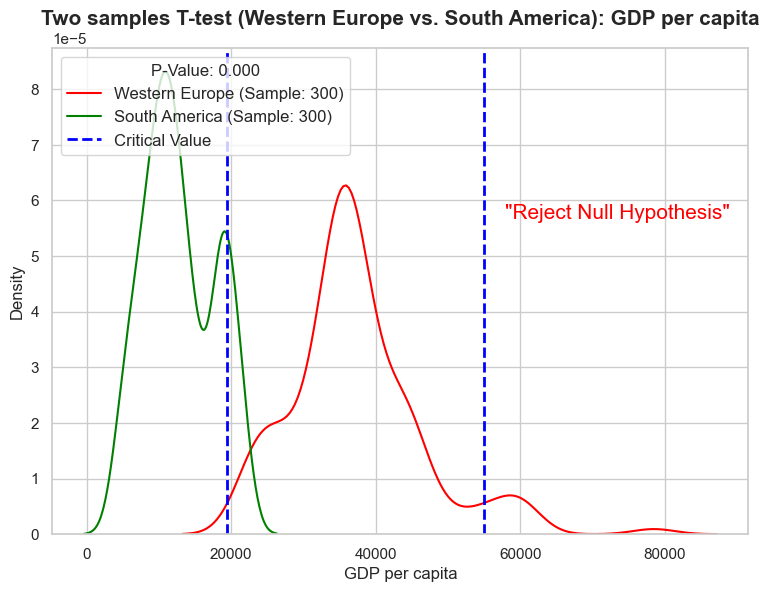

8.95928612206639e-177


In [199]:
# Find critical values 
we_gdp = norm.fit(sample_gdp_western_europe)
we_distribution = norm(loc=np.mean(sample_gdp_western_europe), scale=np.std(sample_gdp_western_europe, ddof=1))
same_distribution = norm(loc=np.mean(sample_gdp_south_america), scale=np.std(sample_gdp_south_america, ddof=1))
critical_value = we_distribution.ppf(0.025)
critical_value2 = we_distribution.ppf(0.975)
# Region vs. region samples t-test (GDP per capita)
plt.figure(figsize=(8, 6))
# Plot the KDE plots for the two samples
sns.kdeplot(sample_gdp_western_europe, color='red', label='Western Europe (Sample: 300)')
sns.kdeplot(sample_gdp_south_america, color='green', label='South America (Sample: 300)')
plt.xlabel('GDP per capita')
plt.ylabel('Density')
plt.title('Two samples T-test (Western Europe vs. South America): GDP per capita', fontsize = 15, fontweight='bold')
t_statistic, p_value = stats.ttest_ind(sample_gdp_western_europe, sample_gdp_south_america, equal_var=True)
plt.axvline(critical_value, color='blue', linestyle='dashed', linewidth=2, label=f'Critical Value')
plt.axvline(critical_value2, color='blue', linestyle='dashed', linewidth=2)
# Add a legend with the p-value
plt.legend(title=f"P-Value: {p_value:.3f}", loc='upper left', fontsize=12)
# Compare the p-value with the significance level 
alpha = 0.05
if p_value < alpha:
    # Reject the null hypothesis
    plt.annotate('"Reject Null Hypothesis"', xy=(0.65, 0.65), xycoords='axes fraction', fontsize=15, color='red')
else:
    # Fail to reject the null hypothesis
    plt.annotate('"Fail to Reject Null Hypothesis"', xy=(0.65, 0.65), xycoords='axes fraction', fontsize=15, color='green')
plt.show()

print(p_value)

In [ ]:
western_europe_gdp_data = final_data[final_data['region_txt'] == 'Western Europe']['GDP per capita']
south_america_gdp_data = final_data[final_data['region_txt'] == 'South America']['GDP per capita']

In [201]:
western_europe_gdp_data

20      23095.736
23      33920.098
25      34260.290
26      21913.797
36      40966.332
          ...    
1207    46650.754
1210    84056.336
1222    30908.120
1224    45192.742
1234    37782.830
Name: GDP per capita, Length: 187, dtype: float64

## Bootstrap T-test between Western Europe and South America - GDP per capita

In [212]:
# Find mean and std values from the selected sample group
western_europe_gdp_mean = np.mean(western_europe_gdp_data)
western_europe_gdp_std = np.std(western_europe_gdp_data)
south_america_gdp_mean = np.mean(south_america_gdp_data)
south_america_gdp_std = np.std(south_america_gdp_data)
# Normalization
western_europe_gdp_normalized = (western_europe_gdp_data - western_europe_gdp_mean) / western_europe_gdp_std
low_incidents_gdp_normalized = (south_america_gdp_data - south_america_gdp_mean) / south_america_gdp_std
# Number of bootstrap samples
num_bootstrap_samples = 1000
# Bootstrap_samples function
def bootstrap_samples(x, num_bootstrap_samples):
    bootstrap_samples = []
    for _ in range(num_bootstrap_samples):
        bootstrap_samples.append(np.mean(np.random.choice(x.squeeze(), size=len(x), replace=True)))
    return bootstrap_samples
# Apply function
western_europe_gdp_bootstrap = bootstrap_samples(western_europe_gdp_normalized, num_bootstrap_samples)
south_america_gdp_bootstrap = bootstrap_samples(low_incidents_gdp_normalized, num_bootstrap_samples)

Step 2 for Bootstrap

In [218]:
# mil_distribution = norm(loc=np.mean(practice_mil), scale=np.std(practice_mil)/(len(practice_mil)))
western_europe_gdp_distribution = norm(loc=np.mean(western_europe_gdp_bootstrap), scale=np.std(western_europe_gdp_bootstrap, ddof=1))
# civ_distribution = norm(loc=np.mean(practice_civ), scale=np.std(practice_civ)/(len(practice_civ)))
south_america_gdp_distribution = norm(loc=np.mean(south_america_gdp_bootstrap), scale=np.std(south_america_gdp_bootstrap, ddof=1))
critical_value_gdp_western_europe_south_america = western_europe_gdp_distribution.ppf(0.025)
critical_value_gdp_western_europe_south_america2 = western_europe_gdp_distribution.ppf(0.975)
# critical_value = null_distribution.ppf(0.95)

print(critical_value_gdp_western_europe_south_america, critical_value_gdp_western_europe_south_america2)

-0.13475149153604907 0.1381468822284203


Step 3 for Bootstrap

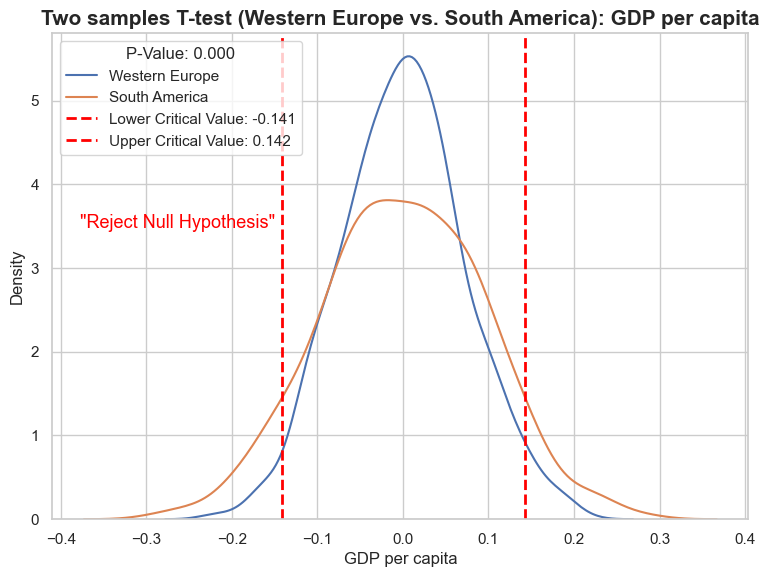

In [211]:
# Perform t-test
t_stat, p_value_ttest = ttest_ind(western_europe_gdp_data, south_america_gdp_data)
# KDE plots
plt.figure(figsize=(8,6))
sns.set(style='whitegrid')
sns.kdeplot(western_europe_gdp_bootstrap, label='Western Europe')
sns.kdeplot(south_america_gdp_bootstrap, label='South America')
plt.axvline(critical_value_gdp_westerneurope_southasia, color='red', linestyle='dashed', linewidth=2, label=f'Lower Critical Value: {critical_value_gdp_westerneurope_southasia:.3f}')
plt.axvline(critical_value_gdp_westerneurope_southasia2, color='red', linestyle='dashed', linewidth=2, label=f'Upper Critical Value: {critical_value_gdp_westerneurope_southasia2:.3f}')
plt.xlabel('GDP per capita')
plt.ylabel('Density')
plt.title('Two samples T-test (Western Europe vs. South America): GDP per capita', fontsize = 15, fontweight='bold')
plt.legend(title=f"P-Value: {p_value_ttest:.3f}", loc='upper left')

alpha = 0.05
if p_value_ttest < alpha:
    # Reject the null hypothesis
    plt.annotate('"Reject Null Hypothesis"', xy=(0.04, 0.6), xycoords='axes fraction', fontsize=13, color='red')
else:
    # Fail to reject the null hypothesis
    plt.annotate('"Fail to Reject Null Hypothesis"', xy=(0.04, 0.6), xycoords='axes fraction', fontsize=13, color='green')
plt.show()

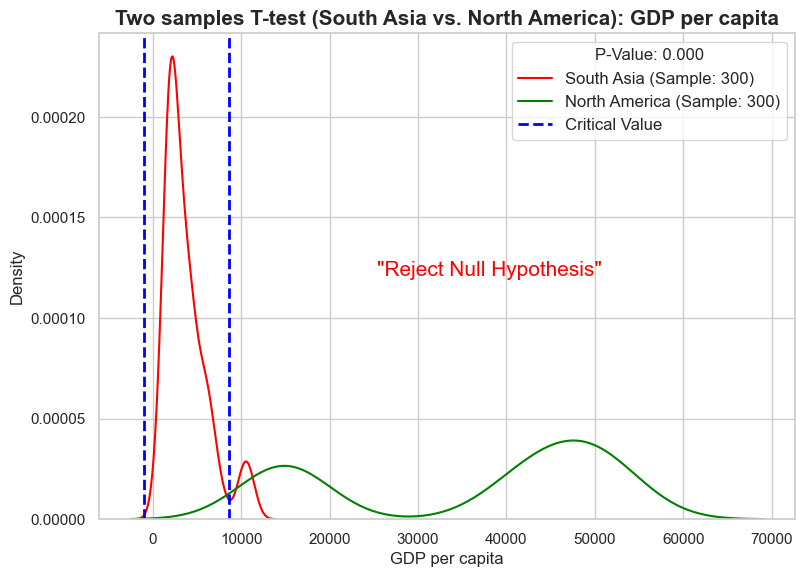

1.2150769198856142e-147


In [43]:
# Find critical values 
sasia_gdp = norm.fit(sample_gdp_south_asia)
sasia_distribution = norm(loc=np.mean(sample_gdp_south_asia), scale=np.std(sample_gdp_south_asia, ddof=1))
name_distribution = norm(loc=np.mean(sample_gdp_north_america), scale=np.std(sample_gdp_north_america, ddof=1))
critical_value = sasia_distribution.ppf(0.025)
critical_value2 = sasia_distribution.ppf(0.975)
# Region vs. region samples t-test (GDP per capita)
plt.figure(figsize=(8, 6))
# Plot the KDE plots for the two samples
sns.kdeplot(sample_gdp_south_asia, color='red', label='South Asia (Sample: 300)')
sns.kdeplot(sample_gdp_north_america, color='green', label='North America (Sample: 300)')
plt.xlabel('GDP per capita')
plt.ylabel('Density')
plt.title('Two samples T-test (South Asia vs. North America): GDP per capita', fontsize = 15, fontweight='bold')
t_statistic, p_value = stats.ttest_ind(sample_gdp_south_asia, sample_gdp_north_america, equal_var=True)
# Add the t-statistic as a vertical dashed line on the plot
plt.axvline(critical_value, color='blue', linestyle='dashed', linewidth=2, label=f'Critical Value')
plt.axvline(critical_value2, color='blue', linestyle='dashed', linewidth=2)

# Add a legend with the p-value
plt.legend(title=f"P-Value: {p_value:.3f}", loc='upper right', fontsize=12)
# Compare the p-value with the significance level 
alpha = 0.05
if p_value < alpha:
    # Reject the null hypothesis
    plt.annotate('"Reject Null Hypothesis"', xy=(0.4, 0.5), xycoords='axes fraction', fontsize=15, color='red')
else:
    # Fail to reject the null hypothesis
    plt.annotate('"Fail to Reject Null Hypothesis"', xy=(0.45, 0.5), xycoords='axes fraction', fontsize=15, color='green')
plt.show()

print(p_value)

## (6.8) QQ Plots

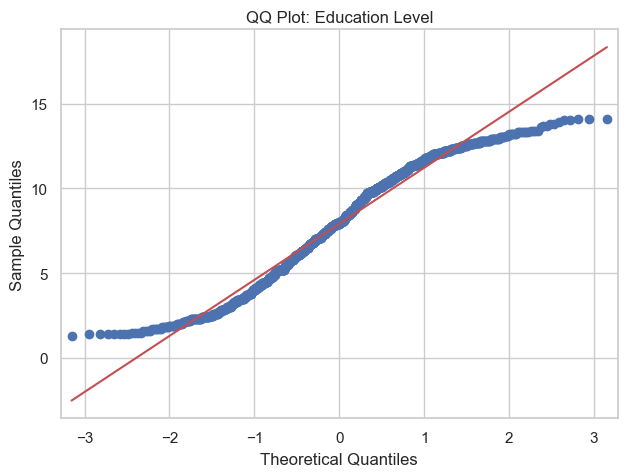

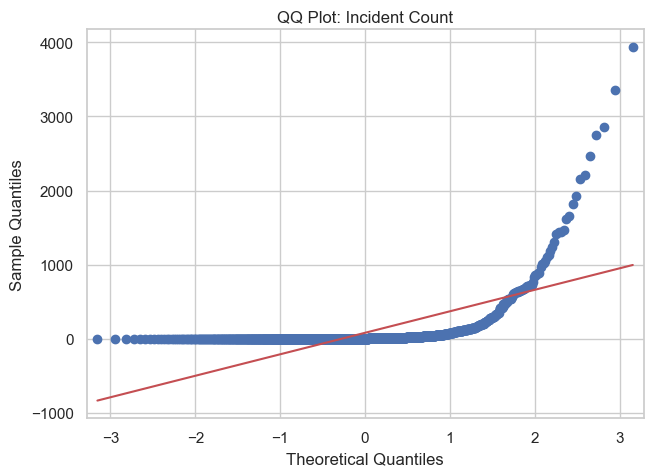

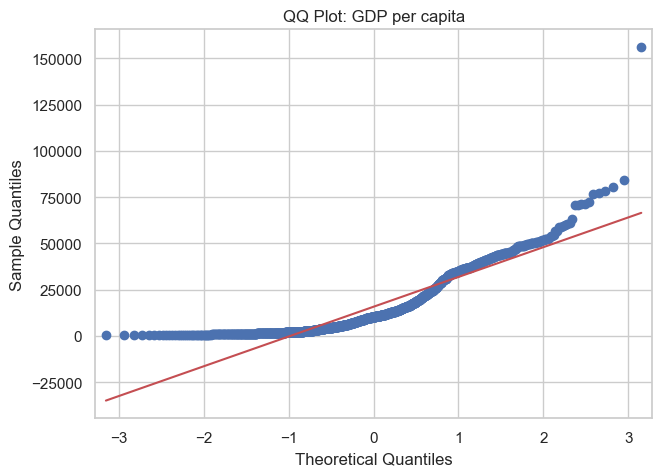

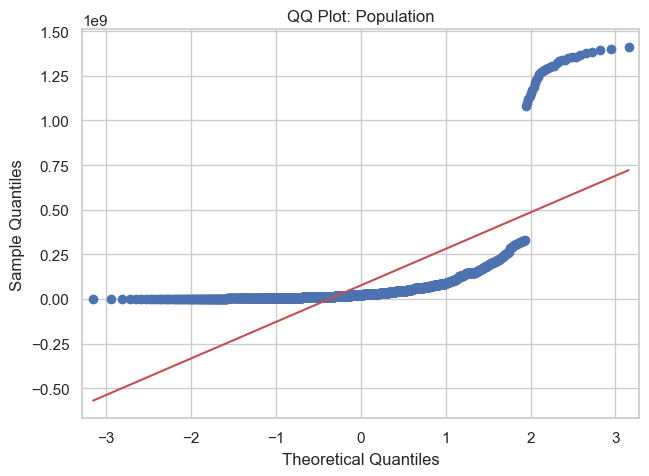

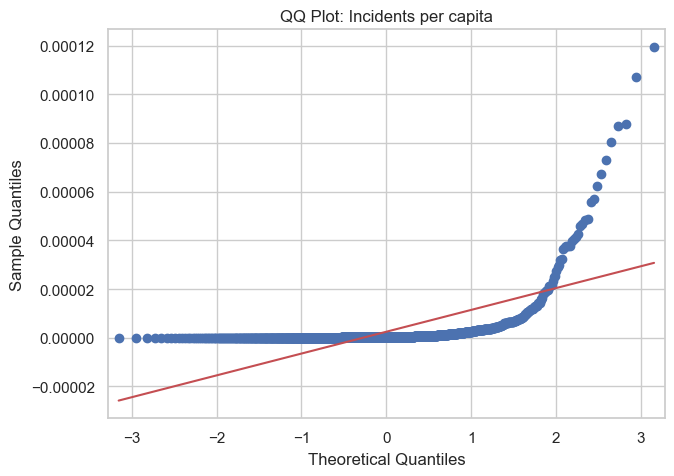

In [44]:
education_level = final_data['education_level']
incident_count = final_data['incident_count']
region_txt = final_data['region_txt']
gdp_per_capita = final_data['GDP per capita']
incident_per_capita = final_data['incident_per_capita']
population = final_data['population']

sm.qqplot(education_level, line='s')
plt.title('QQ Plot: Education Level')
plt.show()
sm.qqplot(incident_count, line='s')
plt.title('QQ Plot: Incident Count')
plt.show()
sm.qqplot(gdp_per_capita, line='s')
plt.title('QQ Plot: GDP per capita')
plt.show()
sm.qqplot(population, line='s')
plt.title('QQ Plot: Population')
plt.show()
sm.qqplot(incident_per_capita, line='s')
plt.title('QQ Plot: Incidents per capita')
plt.show()

### (6.9) T-test between 'high incident' and 'low incident' groups. Group is devided by 'median' value of the incident counts (23)

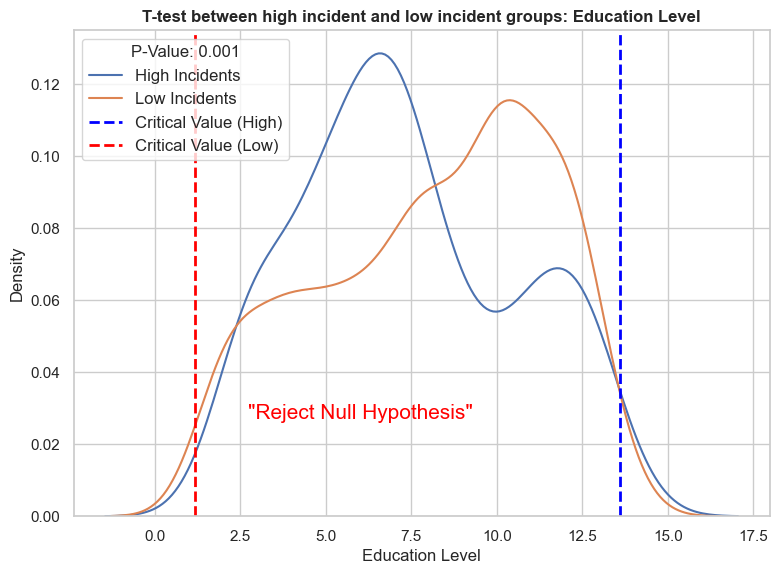

1.2150769198856142e-147


In [45]:
high_incident_group = final_data[final_data['incident_count'] > 23]
low_incident_group = final_data[final_data['incident_count'] <= 23]
# Extract the 'education_level' values
high_education_levels = high_incident_group['education_level'].values
low_education_levels = low_incident_group['education_level'].values
# Calculate the mean and standard deviation of each group
high_mean = np.mean(high_education_levels)
high_std = np.std(high_education_levels, ddof=1)
low_mean = np.mean(low_education_levels)
low_std = np.std(low_education_levels, ddof=1)
# Create normal distributions for each group
high_distribution = norm(loc=high_mean, scale=high_std)
low_distribution = norm(loc=low_mean, scale=low_std)
# Find critical values for each group
critical_value_high = high_distribution.ppf(0.975)
critical_value_low = high_distribution.ppf(0.025)
# Perform t-test
t_stat, p_value_ttest = ttest_ind(high_education_levels, low_education_levels)
# Plot the KDE plots
plt.figure(figsize=(8, 6))
sns.kdeplot(high_education_levels, label='High Incidents')
sns.kdeplot(low_education_levels, label='Low Incidents')
plt.axvline(critical_value_high, color='blue', linestyle='dashed', linewidth=2, label='Critical Value (High)')
plt.axvline(critical_value_low, color='red', linestyle='dashed', linewidth=2, label='Critical Value (Low)')
plt.xlabel('Education Level')
plt.ylabel('Density')
plt.title('T-test between high incident and low incident groups: Education Level', fontweight='bold')
plt.legend(title=f"P-Value: {p_value_ttest:.3f}", loc='upper left', fontsize=12)
# Give the alpha
alpha = 0.05
if p_value < alpha:
    # Reject the null hypothesis
    plt.annotate('"Reject Null Hypothesis"', xy=(0.25, 0.2), xycoords='axes fraction', fontsize=15, color='red')
else:
    # Fail to reject the null hypothesis
    plt.annotate('"Fail to Reject Null Hypothesis"', xy=(0.25, 0.2), xycoords='axes fraction', fontsize=15, color='green')
plt.show()

print(p_value)

## Bootstrap T-test: High and Low incident groups - Education Level

In [163]:
# Extract incident counts from 'high_gdp_group' and 'low_gdp_group'
high_education_levels = high_incident_group['education_level'].values
low_education_levels = low_incident_group['education_level'].values
# Normalize the incident counts
high_mean = np.mean(high_education_levels)
high_std = np.std(low_education_levels)
low_mean = np.mean(high_education_levels)
low_std = np.std(low_education_levels)
# Normalization
high_incidents_edu_normalized = (high_education_levels - high_mean) / high_std
low_incidents_edu_normalized = (low_education_levels - low_mean) / low_std
# Number of bootstrap samples
num_bootstrap_samples = 1000
# Bootstrap_samples function
def bootstrap_samples(x, num_bootstrap_samples):
    bootstrap_samples = []
    for _ in range(num_bootstrap_samples):
        bootstrap_samples.append(np.mean(np.random.choice(x.squeeze(), size=len(x), replace=True)))
    return bootstrap_samples
# Apply function
high_bootstrap_samples_edu = bootstrap_samples(high_incidents_edu_normalized, num_bootstrap_samples)
low_bootstrap_samples_edu = bootstrap_samples(low_incidents_edu_normalized, num_bootstrap_samples)


In [164]:
# mil_distribution = norm(loc=np.mean(practice_mil), scale=np.std(practice_mil)/(len(practice_mil)))
high_edu_distribution = norm(loc=np.mean(high_bootstrap_samples_edu), scale=np.std(high_bootstrap_samples_edu, ddof=1))
# civ_distribution = norm(loc=np.mean(practice_civ), scale=np.std(practice_civ)/(len(practice_civ)))
low_edu_distribution = norm(loc=np.mean(low_bootstrap_samples_edu), scale=np.std(low_bootstrap_samples_edu, ddof=1))
critical_value_edu = high_edu_distribution.ppf(0.025)
critical_value2_edu = high_edu_distribution.ppf(0.975)
# critical_value = null_distribution.ppf(0.95)

print(critical_value_edu, critical_value2_edu)

-0.10123509208696058 0.09979113277336671


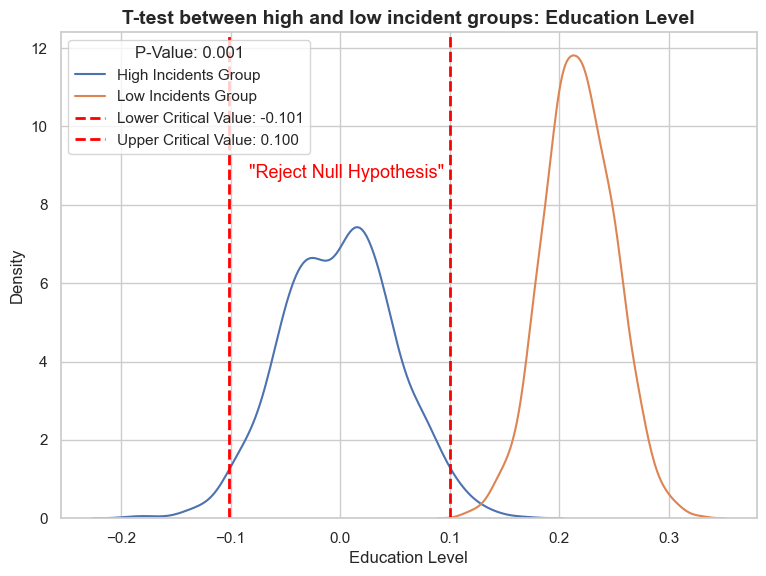

In [198]:
# Perform t-test
t_stat, p_value_ttest = ttest_ind(high_education_levels, low_education_levels)
# KDE plots
plt.figure(figsize=(8,6))
sns.set(style='whitegrid')
sns.kdeplot(high_bootstrap_samples_edu, label='High Incidents Group')
sns.kdeplot(low_bootstrap_samples_edu, label='Low Incidents Group')
plt.axvline(critical_value_edu, color='red', linestyle='dashed', linewidth=2, label=f'Lower Critical Value: {critical_value_edu:.3f}')
plt.axvline(critical_value2_edu, color='red', linestyle='dashed', linewidth=2, label=f'Upper Critical Value: {critical_value2_edu:.3f}')
plt.xlabel('Education Level')
plt.ylabel('Density')
plt.title('T-test between high and low incident groups: Education Level', fontsize=14, fontweight='bold')
plt.legend(title=f"P-Value: {p_value_ttest:.3f}", loc='upper left')

alpha = 0.05
if p_value_ttest < alpha:
    # Reject the null hypothesis
    plt.annotate('"Reject Null Hypothesis"', xy=(0.27, 0.7), xycoords='axes fraction', fontsize=13, color='red')
else:
    # Fail to reject the null hypothesis
    plt.annotate('"Fail to Reject Null Hypothesis"', xy=(0.27, 0.05), xycoords='axes fraction', fontsize=13, color='green')
plt.show()

### (6.10) Box plots between low and high incident groups

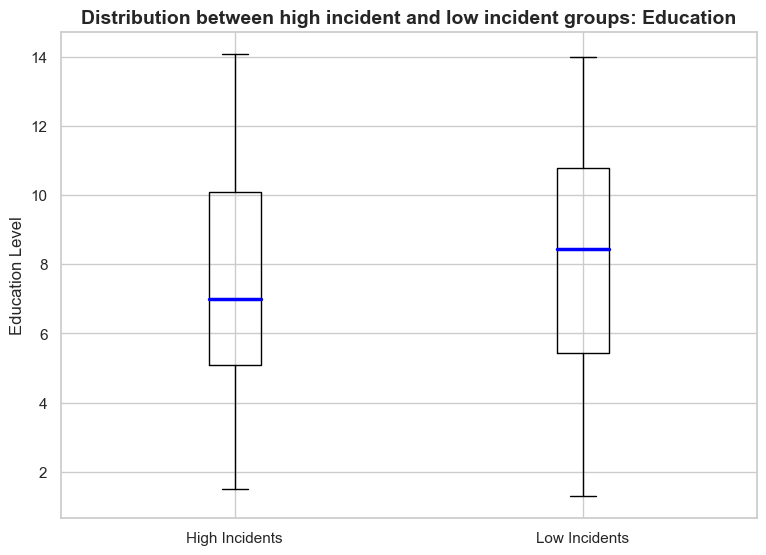

In [46]:
plt.figure(figsize=(8, 6))

# Boxplot data
data = [high_incident_group['education_level'], low_incident_group['education_level']]

# Create the boxplot with custom median properties
median_props = dict(linewidth=2.5, color='blue')  # Customize the line width and color of the median line
boxplot = plt.boxplot(data, labels=['High Incidents', 'Low Incidents'], medianprops=median_props)

# Set labels and title
plt.ylabel('Education Level')
plt.title('Distribution between high incident and low incident groups: Education', fontsize=14, fontweight='bold')

# Show the plot
plt.show()


## (7) Creating a new variable, new_final for different aggregations

In [47]:
new_final = final_data.groupby(['country_txt', 'region_txt']).agg({
    'incident_count': 'sum',
    'GDP per capita': 'mean',
    'education_level': 'mean'
}).reset_index()

new_final['constant'] = 1

### (7.1) T-test between the high incident and low incident group - Education level

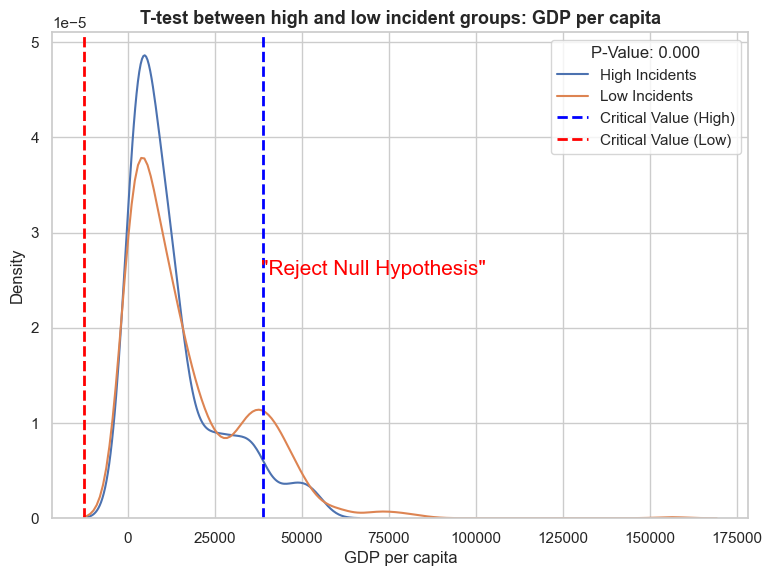

0.00023153810772410803


In [191]:
high_gdp_group = final_data[final_data['incident_count'] > 23]
low_gdp_group = final_data[final_data['incident_count'] <= 23]
# Extract the 'GDP per capita' column for sorting array only
high_gdp = high_gdp_group['GDP per capita'].values
low_gdp = low_gdp_group['GDP per capita'].values
# Calculate the mean and standard deviation of each group
high_mean = np.mean(high_gdp)
high_std = np.std(high_gdp, ddof=1)
low_mean = np.mean(low_gdp)
low_std = np.std(low_gdp, ddof=1)
# Create distribution
high_distribution = norm(loc=high_mean, scale=high_std)
low_distribution = norm(loc=low_mean, scale=low_std)
# Find critical values for each group using t-distribution
critical_value_high = high_distribution.ppf(0.975)
critical_value_low = high_distribution.ppf(0.025)
# Perform t-test
t_stat, p_value_ttest = ttest_ind(high_gdp, low_gdp)
# Plot the KDE plots
plt.figure(figsize=(8, 6))
sns.kdeplot(high_gdp, label='High Incidents')
sns.kdeplot(low_gdp, label='Low Incidents')
plt.axvline(critical_value_high, color='blue', linestyle='dashed', linewidth=2, label='Critical Value (High)')
plt.axvline(critical_value_low, color='red', linestyle='dashed', linewidth=2, label='Critical Value (Low)')
plt.xlabel('GDP per capita')
plt.ylabel('Density')
plt.title('T-test between high and low incident groups: GDP per capita', fontsize=13, fontweight='bold')

plt.legend(title=f"P-Value: {p_value_ttest:.3f}", loc='upper right')

alpha = 0.05
if p_value_ttest < alpha:
    # Reject the null hypothesis
    plt.annotate('"Reject Null Hypothesis"', xy=(0.3, 0.5), xycoords='axes fraction', fontsize=15, color='red')
else:
    # Fail to reject the null hypothesis
    plt.annotate('"Fail to Reject Null Hypothesis"', xy=(0.3, 0.5), xycoords='axes fraction', fontsize=15, color='green')
plt.show()

print(p_value_ttest)

In [151]:
# Extract incident counts from 'high_gdp_group' and 'low_gdp_group'
high_incidents_gdp = high_gdp_group['incident_count'].values
low_incidents_gdp = low_gdp_group['incident_count'].values
# Normalize the incident counts
high_mean = np.mean(high_incidents_gdp)
high_std = np.std(high_incidents_gdp)
low_mean = np.mean(low_incidents_gdp)
low_std = np.std(low_incidents_gdp)
# Normalization
high_incidents_gdp_normalized = (high_incidents_gdp - high_mean) / high_std
low_incidents_gdp_normalized = (low_incidents_gdp - low_mean) / low_std
# Number of bootstrap samples
num_bootstrap_samples = 1000
# Bootstrap_samples function
def bootstrap_samples(x, num_bootstrap_samples):
    bootstrap_samples = []
    for _ in range(num_bootstrap_samples):
        bootstrap_samples.append(np.mean(np.random.choice(x.squeeze(), size=len(x), replace=True)))
    return bootstrap_samples
# Apply function
high_bootstrap_samples_gdp = bootstrap_samples(high_incidents_gdp_normalized, num_bootstrap_samples)
low_bootstrap_samples_gdp = bootstrap_samples(low_incidents_gdp_normalized, num_bootstrap_samples)


In [152]:
print("High Incident - GDP (samples):", np.mean(high_bootstrap_samples_gdp), np.std(high_bootstrap_samples_gdp))
print("Low Incident - GDP (samples):", np.mean(low_bootstrap_samples_gdp), np.std(low_bootstrap_samples_gdp))

High Incident - GDP (samples): 0.00040750182691689916 0.05346243539178394
Low Incident - GDP (samples): -0.0007287380589689563 0.03335097469798514


In [153]:
t_statistic, p_value = stats.ttest_ind(high_bootstrap_samples_gdp, low_bootstrap_samples_gdp, equal_var=False)
print(t_statistic, p_value)

0.5699399596126823 0.5687948867796138


Sample boot strap distribution & Critical values

In [154]:
# mil_distribution = norm(loc=np.mean(practice_mil), scale=np.std(practice_mil)/(len(practice_mil)))
high_gdp_distribution = norm(loc=np.mean(high_bootstrap_samples_gdp), scale=np.std(high_bootstrap_samples_gdp, ddof=1))
# civ_distribution = norm(loc=np.mean(practice_civ), scale=np.std(practice_civ)/(len(practice_civ)))
low_gdp_distribution = norm(loc=np.mean(low_bootstrap_samples_gdp), scale=np.std(low_bootstrap_samples_gdp, ddof=1))
critical_value_gdp = high_gdp_distribution.ppf(0.025)
critical_value2_gdp = high_gdp_distribution.ppf(0.975)
# critical_value = null_distribution.ppf(0.95)

print(critical_value_gdp, critical_value2_gdp)

-0.10442937761766782 0.1052443812715016


## T-test and distribution with bootstrap method - GDP per capita

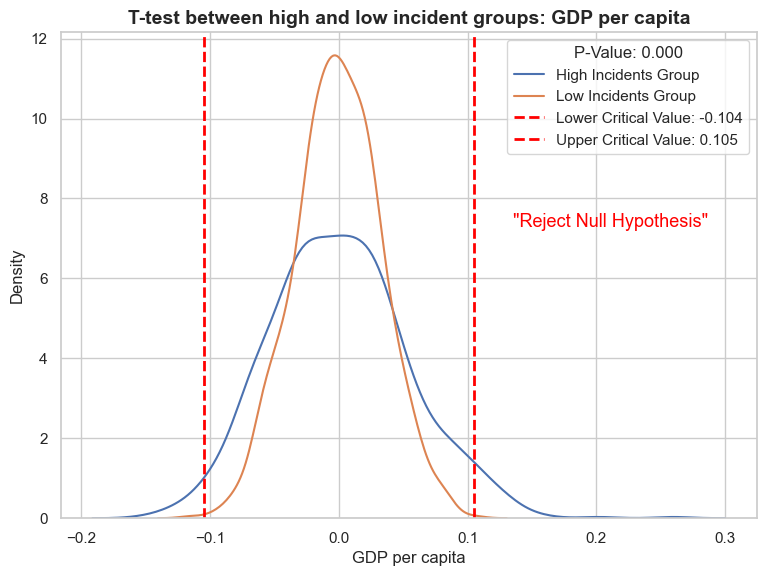

In [192]:
# Perform t-test
t_stat, p_value_ttest = ttest_ind(high_incidents_gdp, low_incidents_gdp)
# KDE plots
plt.figure(figsize=(8,6))
sns.set(style='whitegrid')
sns.kdeplot(high_bootstrap_samples_gdp, label='High Incidents Group')
sns.kdeplot(low_bootstrap_samples_gdp, label='Low Incidents Group')
plt.axvline(critical_value_gdp, color='red', linestyle='dashed', linewidth=2, label=f'Lower Critical Value: {critical_value_gdp:.3f}')
plt.axvline(critical_value2_gdp, color='red', linestyle='dashed', linewidth=2, label=f'Upper Critical Value: {critical_value2_gdp:.3f}')
plt.xlabel('GDP per capita')
plt.ylabel('Density')
plt.title('T-test between high and low incident groups: GDP per capita', fontsize=14, fontweight='bold')
plt.legend(title=f"P-Value: {p_value_ttest:.3f}", loc='upper right')

alpha = 0.05
if p_value_ttest < alpha:
    # Reject the null hypothesis
    plt.annotate('"Reject Null Hypothesis"', xy=(0.65, 0.6), xycoords='axes fraction', fontsize=13, color='red')
else:
    # Fail to reject the null hypothesis
    plt.annotate('"Fail to Reject Null Hypothesis"', xy=(0.65, 0.6), xycoords='axes fraction', fontsize=13, color='green')
plt.show()

### (7.2) Boxplot between the high incident and low incident group - Education level

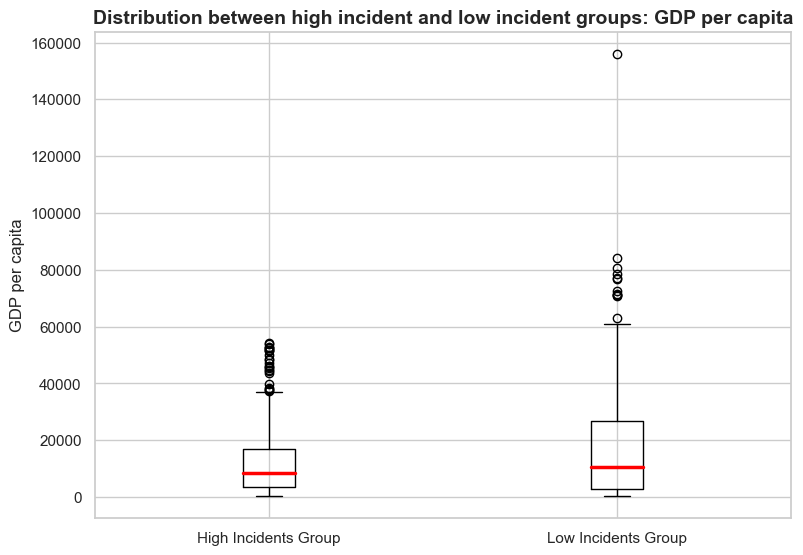

In [ ]:
plt.figure(figsize=(8, 6))
# Pull boxplot data
data = [high_incident_group['GDP per capita'], low_incident_group['GDP per capita']]
# Create the boxplot with custom median properties
median_props = dict(linewidth=2.5, color='red')  # Customize the line width and color of the median line
boxplot = plt.boxplot(data, labels=['High Incidents Group', 'Low Incidents Group'], medianprops=median_props)
# Set labels and title
plt.ylabel('GDP per capita')
plt.title('Distribution between high incident and low incident groups: GDP per capita', fontsize=14, fontweight='bold')
# Show the plot
plt.show()

## (8) Creating a new variable with final data (Sum number of incidents by country, find the average GDP and education level)

In [ ]:
new_final = final_data.groupby(['country_txt', 'region_txt']).agg({
    'incident_count': 'sum',
    'GDP per capita': 'mean',
    'education_level': 'mean'
}).reset_index()

new_final['constant'] = 1

new_final

,country_txt,region_txt,incident_count,GDP per capita,education_level,constant
0,Afghanistan,South Asia,12593,1437.658194,3.035294,1
1,Albania,Eastern Europe,13,8836.755750,9.512500,1
2,Algeria,Middle East & North Africa,1212,11560.511588,7.176471,1
3,Angola,Sub-Saharan Africa,57,5982.143733,4.733333,1
4,Argentina,South America,24,17885.798167,9.616667,1
...,...,...,...,...,...,...
132,Venezuela,South America,56,16560.460417,8.741667,1
133,Vietnam,Southeast Asia,6,4668.886200,6.900000,1
134,Yemen,Middle East & North Africa,3230,4023.590600,2.418750,1
135,Zambia,Sub-Saharan Africa,3,2538.302300,6.550000,1


### (8.1) Build a prediction model using independent variables including the constant, which is '1'. This will calculate the 'predicted incident count'.

Find the RMSE value

In [ ]:
# Define X and y
X = new_final[['GDP per capita', 'education_level', 'constant']]
y = new_final['incident_count']
# Fit the linear regression model
model = sm.OLS(y, X).fit()
# Get the predicted values from the model
y_pred = model.predict(X)
# Calculate the RMSE
rmse = np.sqrt(np.mean((y - y_pred) ** 2))
print(f'RMSE: {rmse:.2f}')

RMSE: 2674.57


In [ ]:
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:         incident_count   R-squared:                       0.030
Model:                            OLS   Adj. R-squared:                  0.015
Method:                 Least Squares   F-statistic:                     2.039
Date:                Wed, 09 Aug 2023   Prob (F-statistic):              0.134
Time:                        21:54:33   Log-Likelihood:                -1275.5
No. Observations:                 137   AIC:                             2557.
Df Residuals:                     134   BIC:                             2566.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
GDP per capita     -0.0074      0.017     

Get the pridicted incident count data by predicting the model

In [ ]:
X = new_final[['GDP per capita', 'education_level', 'constant']]
y = new_final['incident_count']
# Fit the linear regression model
model = sm.OLS(y, X).fit()
# Get the predicted incident count from the model
new_final['predicted_incident_count'] = model.predict(X)
# Group the data by 'region_txt' and find the country with the highest predicted incident count in each region
highest_incidents_by_region = new_final.groupby('region_txt').apply(lambda group: group.loc[group['predicted_incident_count'].idxmax()])
# Create a new variable with cacluated prediction data
result_regression = highest_incidents_by_region[['region_txt', 'country_txt', 'predicted_incident_count']]
result_regression.head(4)


,region_txt,country_txt,predicted_incident_count
region_txt,,,
Australasia & Oceania,Australasia & Oceania,New Zealand,180.418355
Central America & Caribbean,Central America & Caribbean,Guatemala,1290.011879
Central Asia,Central Asia,Turkmenistan,669.611034
East Asia,East Asia,China,895.039584


Find the mean RMSE from the K-fold cross-validation (k=5)

In [ ]:
model = LinearRegression()
# Perform k-fold cross-validation
k = 5
scores = cross_val_score(model, X, y, cv=k, scoring='neg_mean_squared_error')
mean_rmse = np.sqrt(-scores.mean())
print(f'Mean RMSE from {k}-fold cross-validation: {mean_rmse:.2f}')

Mean RMSE from 5-fold cross-validation: 2692.88


Plot the k-fold results in a graph

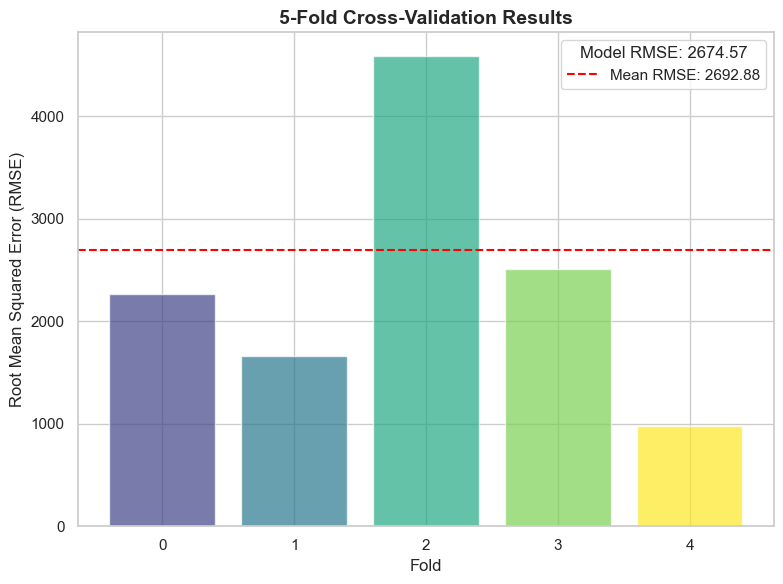

In [ ]:
plt.figure(figsize=(8, 6))
color_map = 'viridis'
bars = plt.bar(range(k), np.sqrt(-scores), color=plt.cm.get_cmap(color_map)(np.linspace(0.2, 1, k)), alpha=0.7)

plt.axhline(y=mean_rmse, color='red', linestyle='--', label=f'Mean RMSE: {mean_rmse:.2f}')
plt.xlabel('Fold')
plt.ylabel('Root Mean Squared Error (RMSE)')
plt.title(f'{k}-Fold Cross-Validation Results', fontsize=14, fontweight='bold')
plt.legend(title=f"Model RMSE: {rmse:.2f}", loc='upper right')
plt.tight_layout()
plt.show()


Plot residual analysis

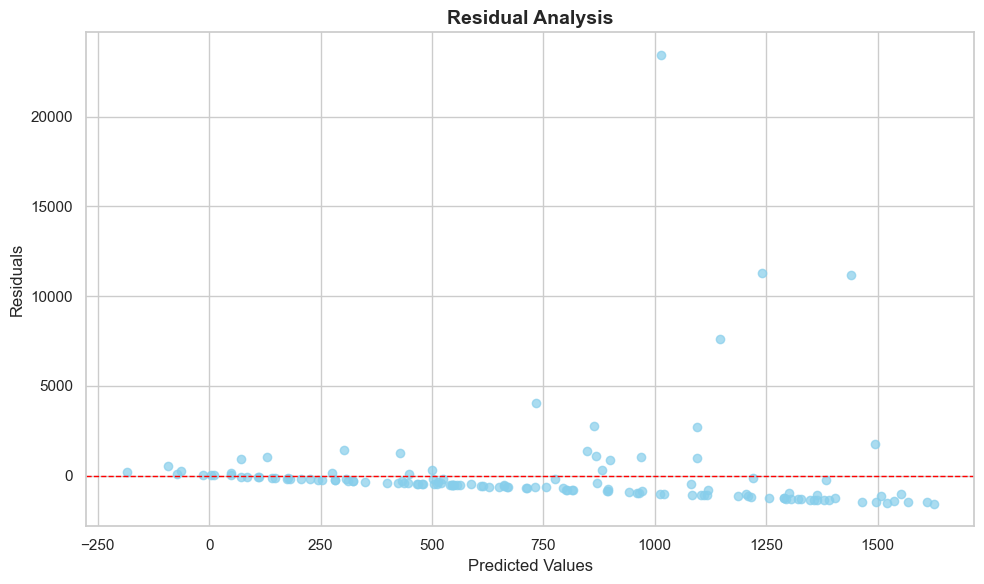

In [ ]:
model = LinearRegression()
# Fit the linear regression model
model.fit(X, y)
# Get the predicted values from the model
y_pred = model.predict(X)
# Calculate the residuals (difference between observed and predicted values)
residuals = y - y_pred
# Plot the Residual Analysis plot
plt.figure(figsize=(10, 6))
plt.scatter(y_pred, residuals, color='skyblue', alpha=0.7)
plt.axhline(y=0, color='red', linestyle='--', linewidth=1)
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.title('Residual Analysis', fontsize=14, fontweight='bold')
plt.tight_layout()
plt.show()


In [ ]:
# Divide train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
# Create the linear regression model
model = LinearRegression()
# Fit the model with training data (X_train, y_train)
model.fit(X_train, y_train)
# Make predictions on the test set
y_pred = model.predict(X_test)
# Calculate R-squared, MAE, MSE, and RMSE
r_squared = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
print(f'R-squared: {r_squared:.2f}')
print(f'MAE: {mae:.2f}')
print(f'MSE: {mse:.2f}')
print(f'RMSE: {rmse:.2f}')

R-squared: -1.15
MAE: 728.68
MSE: 729949.79
RMSE: 854.37


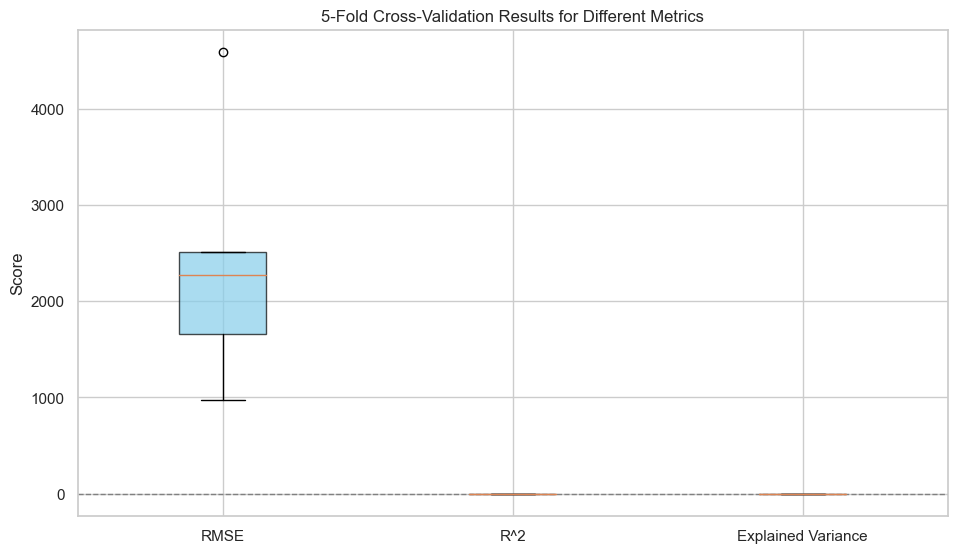

In [ ]:

model = LinearRegression()

# Define the metrics to be evaluated
scoring_metrics = ['neg_mean_squared_error', 'r2', 'explained_variance']

# Perform k-fold cross-validation for each metric
k = 5
scores = {}
for metric in scoring_metrics:
    scores[metric] = cross_val_score(model, X, y, cv=k, scoring=metric)

# Plot the cross-validation results using box plots
plt.figure(figsize=(10, 6))
plt.boxplot([np.sqrt(-scores['neg_mean_squared_error']), scores['r2'], scores['explained_variance']], 
            labels=['RMSE', 'R^2', 'Explained Variance'], patch_artist=True, boxprops=dict(facecolor='skyblue', alpha=0.7))
plt.axhline(y=0, color='gray', linestyle='--', linewidth=1)  # Reference line for R^2 and Explained Variance
plt.ylabel('Score')
plt.title(f'{k}-Fold Cross-Validation Results for Different Metrics')
plt.show()


In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
import numpy as np

# Create an instance of the linear regression model
model = LinearRegression()

# Perform k-fold cross-validation (e.g., k=5)
k = 5
cv_scores = cross_val_score(model, X, y, cv=k, scoring='neg_mean_squared_error')

# Convert negative MSE scores to positive RMSE scores
rmse_scores = np.sqrt(-cv_scores)

# Calculate the mean and standard deviation of RMSE scores
mean_rmse = np.mean(rmse_scores)
std_rmse = np.std(rmse_scores)

print(f'Mean RMSE from {k}-fold cross-validation: {mean_rmse:.2f}')
print(f'Standard deviation of RMSE: {std_rmse:.2f}')


Mean RMSE from 5-fold cross-validation: 2401.67
Standard deviation of RMSE: 1218.01


# (10) Prediction

## (10.1) Predict top 5 countries from each regions

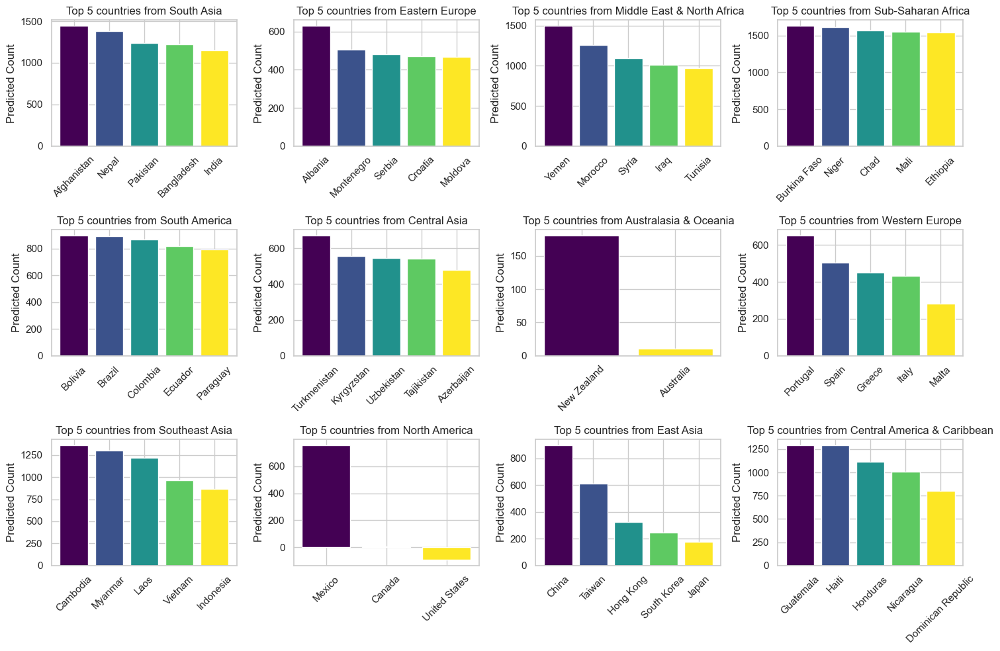

In [ ]:
# Sort by regions
unique_regions = new_final['region_txt'].unique()
plt.figure(figsize=(15, 10))
# Create bar charts with for loop
for i, region in enumerate(unique_regions, start=1):
    plt.subplot(3, 4, i)
    region_data = new_final[new_final['region_txt'] == region]
    # Sort the data
    region_data_sorted = region_data.sort_values(by='predicted_incident_count', ascending=False)
    # Sort by top 5 countries within regions
    top_countries = region_data_sorted.head(5)
    countries = top_countries['country_txt']
    predicted_incident_counts = top_countries['predicted_incident_count']
    # Color setting
    bar_colors = plt.cm.viridis(np.linspace(0, 1, len(top_countries)))
    plt.bar(range(len(top_countries)), predicted_incident_counts, color=bar_colors)
    
    plt.xticks(range(len(top_countries)), countries, rotation=45)
    
    plt.title(f'Top 5 countries from {region}')
    plt.ylabel('Predicted Count')

plt.tight_layout()
plt.show()


## (10.2) Predict top country from each region and draw in bar chart

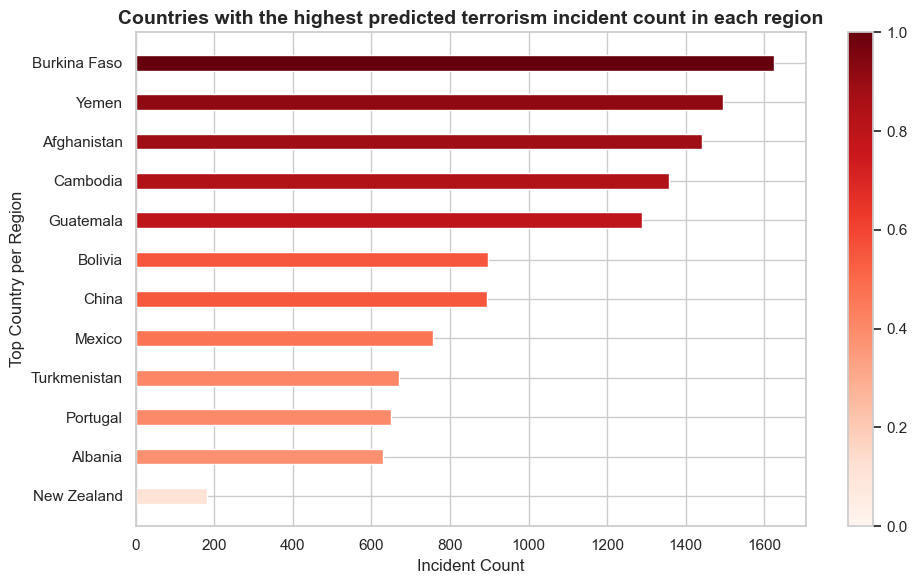

In [ ]:
plt.figure(figsize=(10, 6))
bar_width = 0.4
highest_incidents_by_region_sorted = highest_incidents_by_region.sort_values(by='predicted_incident_count', ascending=True)
index = np.arange(len(highest_incidents_by_region_sorted))
# Set color map with viridis
color_map = 'Reds'

# Create the bar chart with gradation
bars = plt.barh(index, highest_incidents_by_region_sorted['predicted_incident_count'], 
                height=bar_width, color=plt.cm.get_cmap(color_map)(highest_incidents_by_region_sorted['predicted_incident_count'] 
                                                                   / highest_incidents_by_region_sorted['predicted_incident_count'].max()))

# Add a color bar
cbar = plt.colorbar(mappable=plt.cm.ScalarMappable(cmap=color_map))

plt.xlabel('Incident Count')
plt.ylabel('Top Country per Region')
plt.title('Countries with the highest predicted terrorism incident count in each region', fontsize=14, fontweight='bold')
plt.yticks(index, highest_incidents_by_region_sorted['country_txt'])
plt.tight_layout()
plt.show()


## (10.3) Predict top 10 countries regardless of the regions

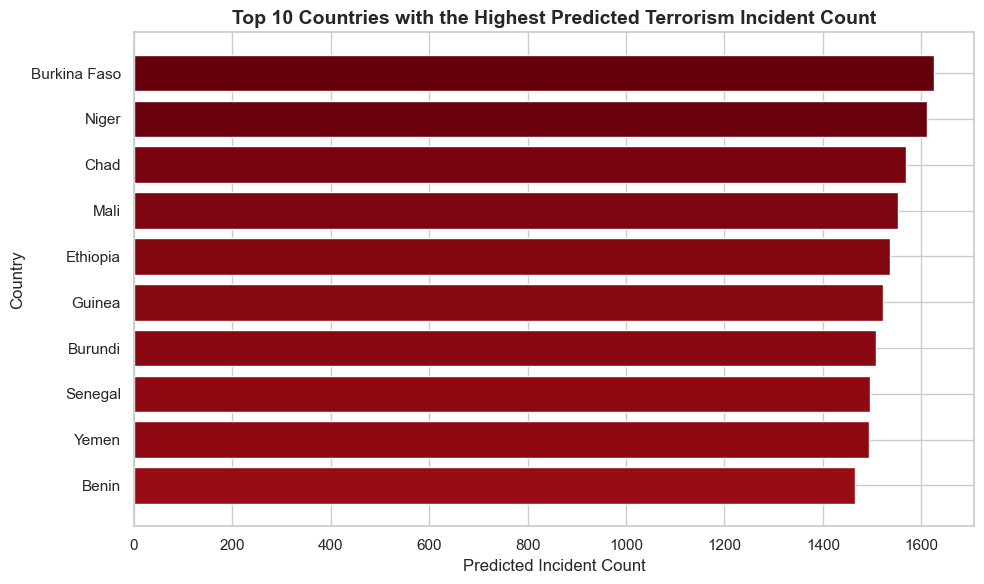

In [ ]:
top_10_countries = new_final.sort_values(by='predicted_incident_count', ascending=False).head(10)


plt.figure(figsize=(10, 6))
color_map = 'Reds'

bars = plt.barh(top_10_countries['country_txt'], top_10_countries['predicted_incident_count'], 
                color=plt.cm.get_cmap(color_map)(top_10_countries['predicted_incident_count'] / top_10_countries['predicted_incident_count'].max()))

plt.xlabel('Predicted Incident Count')
plt.ylabel('Country')
plt.title('Top 10 Countries with the Highest Predicted Terrorism Incident Count', fontsize=14, fontweight='bold')
plt.gca().invert_yaxis()
plt.tight_layout()
plt.show()


# (11) Logistic regression

In [ ]:
total_incidents_by_country.head()

,country_txt,region_txt,total_incidents
68,Iraq,Middle East & North Africa,24465
0,Afghanistan,South Asia,12593
109,Pakistan,South Asia,12502
64,India,South Asia,8738
114,Philippines,Southeast Asia,4788


In [ ]:
# Create a binary target variable based on median incident count
final_data['incident_binary'] = (final_data['incident_count'] > median_incident_by_country).astype(int)
# Define predictors and target variable
logistic_X = final_data[['education_level', 'GDP per capita', 'incident_per_capita', 'population']]
logistic_y = final_data['incident_binary']
# Scale the predictors
scaler = StandardScaler()
logistic_X_scaled = scaler.fit_transform(logistic_X)
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(logistic_X_scaled, logistic_y, test_size=0.2, random_state=42)
# Fit the logistic regression model
logistic_model = sm.Logit(y_train, sm.add_constant(X_train)).fit()
print(logistic_model.summary())
# Make predictions on the test set
y_pred = logistic_model.predict(sm.add_constant(X_test))
y_pred_binary = (y_pred > 0.33).astype(int)
# Evaluate the model
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred_binary))
print("\nClassification Report:")
print(classification_report(y_test, y_pred_binary))


Optimization terminated successfully.
         Current function value: 0.343304
         Iterations 9
                           Logit Regression Results                           
Dep. Variable:        incident_binary   No. Observations:                  992
Model:                          Logit   Df Residuals:                      987
Method:                           MLE   Df Model:                            4
Date:                Wed, 09 Aug 2023   Pseudo R-squ.:                  0.4231
Time:                        21:54:38   Log-Likelihood:                -340.56
converged:                       True   LL-Null:                       -590.31
Covariance Type:            nonrobust   LLR p-value:                8.553e-107
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.4934      0.181      2.730      0.006       0.139       0.848
x1             0.0390      0.

Find precision and recall

In [ ]:
conf_matrix = confusion_matrix(y_test, y_pred_binary)
true_positive = conf_matrix[1, 1]
false_positive = conf_matrix[0, 1]
false_negative = conf_matrix[1, 0]
precision = true_positive / (true_positive + false_positive)
recall = true_positive / (true_positive + false_negative)

print(f"\nPrecision: {precision:.3f}")
print(f"Recall: {recall:.3f}")



Precision: 0.754
Recall: 0.687


Plot confusion matrix

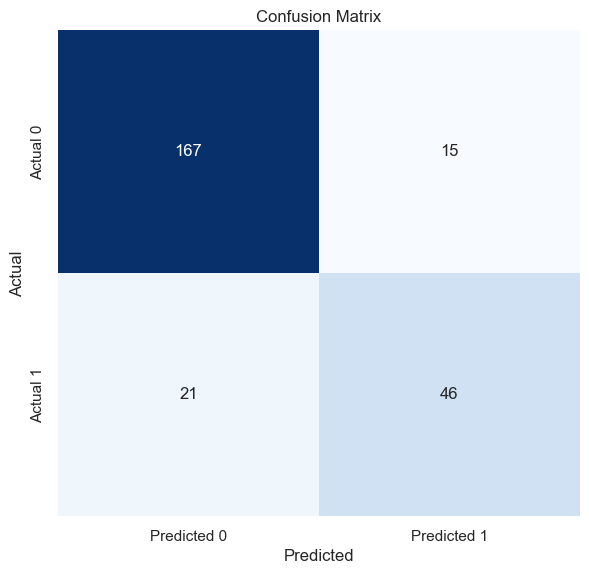

In [ ]:
conf_matrix = confusion_matrix(y_test, y_pred_binary)

plt.figure(figsize=(6, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.xticks([0.5, 1.5], ['Predicted 0', 'Predicted 1'])
plt.yticks([0.5, 1.5], ['Actual 0', 'Actual 1'])
plt.show()


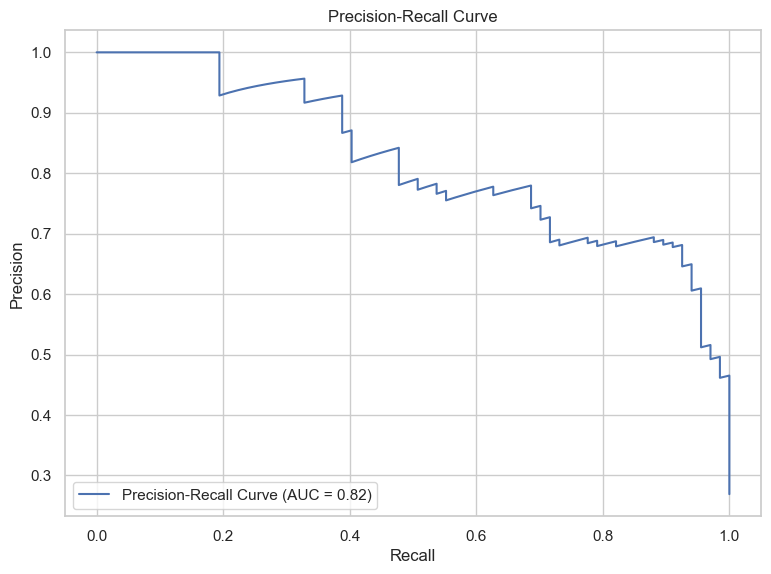

In [ ]:
y_pred = logistic_model.predict(sm.add_constant(X_test))
# Calculate precision-recall curve
precision, recall, thresholds = precision_recall_curve(y_test, y_pred)
# Calculate area under the curve (AUC) for precision-recall curve
auc_score = auc(recall, precision)
# Plot precision-recall curve
plt.figure(figsize=(8, 6))
plt.plot(recall, precision, color='b', label='Precision-Recall Curve (AUC = {:.2f})'.format(auc_score))
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend(loc='lower left')
plt.grid(True)
plt.show()

Cross-validation

In [ ]:
# Create a binary target variable based on mean incident count
mean_incident_count = final_data['incident_count'].mean()
final_data['incident_binary'] = (final_data['incident_count'] > median_incident_by_country).astype(int)
# Define predictors and target variable
logistic_X = final_data[['education_level', 'GDP per capita', 'incident_per_capita', 'population']]
logistic_y = final_data['incident_binary']
# Scale the predictors
scaler = StandardScaler()
logistic_X_scaled = scaler.fit_transform(logistic_X)
# Create a logistic regression model
logistic_model = LogisticRegression()
# Perform k-fold cross-validation (k=5 in this example)
num_folds = 5
cross_val_scores = cross_val_score(logistic_model, logistic_X_scaled, logistic_y, cv=num_folds, scoring='accuracy')
# Print the cross-validation scores
print("Cross-Validation Scores:", cross_val_scores)
print("Mean Cross-Validation Score:", cross_val_scores.mean())

Cross-Validation Scores: [0.78714859 0.87903226 0.86290323 0.88306452 0.8266129 ]
Mean Cross-Validation Score: 0.8477522995206634


Prediction with regression model

Optimization terminated successfully.
         Current function value: 0.346928
         Iterations 9


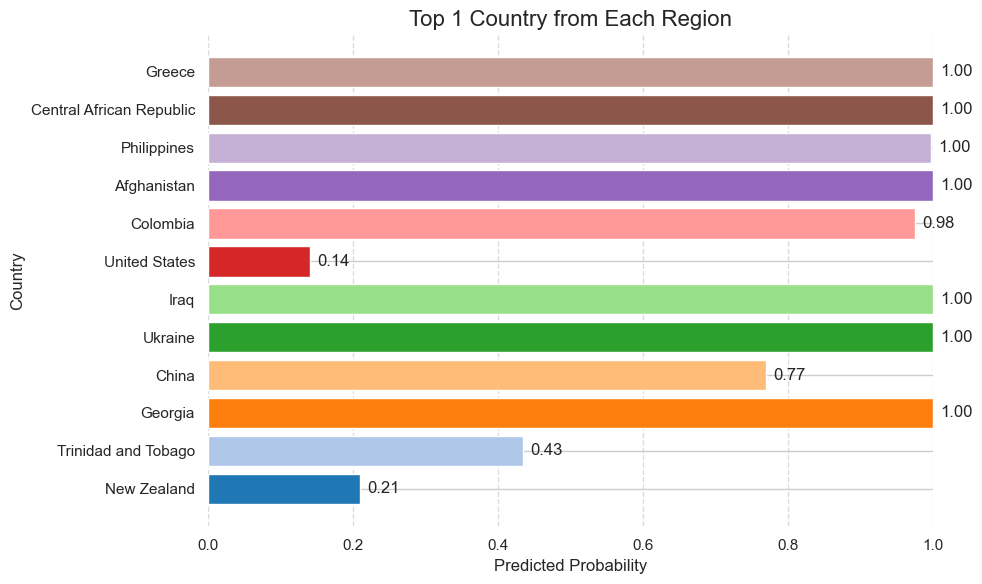

In [ ]:
# Fit the logistic regression model
logistic_model = sm.Logit(logistic_y, sm.add_constant(logistic_X_scaled)).fit()
# Get predicted probabilities for each country
predicted_probs = logistic_model.predict(sm.add_constant(logistic_X_scaled))
# Add predicted probabilities to the final_data DataFrame
final_data['predicted_probability'] = predicted_probs
# Function to get top 1 country from each region based on predicted probabilities
def top_1_country(group):
    return group.nlargest(1, 'predicted_probability')
# Group data by regions and select top 1 country from each group
top_countries_per_region = final_data.groupby('region_txt').apply(top_1_country)
# Plot the top 1 country from each region (horizontal bar chart)
plt.figure(figsize=(10, 6))
colors = plt.cm.tab20.colors[:len(top_countries_per_region)]
plt.barh(top_countries_per_region['country_txt'], top_countries_per_region['predicted_probability'], color=colors)
plt.xlabel('Predicted Probability')
plt.ylabel('Country')
plt.title('Top 1 Country from Each Region', fontsize=16)
plt.xlim(0, 1)
# Add data labels to the bars
for i, (country, prob) in enumerate(zip(top_countries_per_region['country_txt'], top_countries_per_region['predicted_probability'])):
    plt.text(prob + 0.01, i, f'{prob:.2f}', va='center', fontsize=12)
# Remove spines and grid
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_visible(False)
plt.gca().spines['bottom'].set_visible(False)
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()
